## **IMI BIG DATA & AI CASE COMPETITION**

## *By: Hafsa, Cindy, Tahir & Albert*

# Table of Contents:
1. [Initial Set-Up & Import Data](#1)
2. [Exploratory Data Analysis](#2) 
    1. [Dataset, Datatypes, Missing Data, Duplicates, Graphs](#2.1)
    2. [Data Cleaning Methods](#2.2)
        1. [Data Prep -- Column Types, Date Manipulations, Removing outliers](#2.2.1)
        2. [Missing Values - Simple Imputer (Mean, Median, Random Imputation, Average Growth)](#2.2.2)
        3. [Missing Values - Three Year Average](#2.2.3)
        4. [Missing Values - Complex Imputer (Deterministic, Stochastic Regression, KNN)](#2.2.4)
    2. [Further Analysis (Barplots, Scatterplots, CustomerID, Classes, Clustering)](#2.2)
    3. [Data Distributions by Features & Investment Type](#2.3)

# Initial Set-Up & Import Data <a class="anchor" id="1"></a>

In [47]:
# Import relevent Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import gc
import math

# Model Metrics & Data Pre-processing 
from scipy import stats
from sklearn import metrics
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score
from sklearn.metrics import confusion_matrix, roc_auc_score, roc_curve, classification_report, precision_recall_curve
from sklearn.model_selection import train_test_split, cross_val_score, StratifiedKFold, GridSearchCV, RandomizedSearchCV

#Models
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.gaussian_process.kernels import RBF
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import GradientBoostingClassifier

#import lightgbm and xgboost 
import lightgbm as lgb 
import xgboost as xgb 

# Imbalance dataset methods
from imblearn.over_sampling import SMOTE
from imblearn.over_sampling import ADASYN
from imblearn.combine import SMOTETomek
from imblearn.combine import SMOTEENN

# Miscellaneous
from collections import Counter

# Additional Libraries -- Automatic Explanatory Data Analysis
from pandas_profiling import ProfileReport
from IPython.core.display import display, HTML

# Remove warnings (so it doesn't take up space)
import warnings
warnings.filterwarnings('ignore')

# Set seed for repition 
np.random.seed(2022)

In [17]:
# Some settings for making the tables, plots and the report look nicer
sns.set_theme()
%matplotlib inline
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', 999)
display(HTML("<style>.container { width:80% !important; }</style>"))
display(HTML("<style>.container { length:100% !important; }</style>")) 

In [18]:

# Read in the data
# Canadian Companies Data
df1 = pd.read_excel("/Users/tahir/Desktop/Fraudit/Datasets/cmeg_df_case_competition_scrambled_train.xlsx")

# General Companies Data
df2 = pd.read_excel("/Users/tahir/Desktop/Fraudit/Datasets/general_industries_df_case_competition_scrambled_train.xlsx")

# Data Dictionary from Canadian Companies Dataset (Although both data dictionaries are the same) 
data_dictionary = pd.read_excel("/Users/tahir/Desktop/Fraudit/Datasets/cmeg_df_case_competition_scrambled_train.xlsx", sheet_name=1)


In [19]:
# GOOGLE COLLAB MEMBERS -- PLEASE UNCOMMENT AND RUN THIS BELOW 
"""
# load Google Drive onto colab
from google.colab import drive 
drive.mount('/content/gdrive') # Make sure you have a copy of the shared google drive folder in your personal drive

# load the cmeg training data set:
df1 = pd.read_excel("gdrive/My Drive/IMI Competition 2022/Datasets/cmeg_df_case_competition_scrambled_train.xlsx")

# load the general_industries training data set:
df2 = pd.read_excel("gdrive/My Drive/IMI Competition 2022/Datasets/general_industries_df_case_competition_scrambled_train.xlsx")

# read the second sheet with the data key
data_dictionary = pd.read_excel("gdrive/My Drive/IMI Competition 2022/Datasets/general_industries_df_case_competition_scrambled_train.xlsx", sheet_name=1)
"""
print(" ")

# Exploratory Data Analysis <a class="anchor" id="2"></a>

## Dataset, Datatypes, Missing Data & Duplicates <a class="anchor" id="2.1"></a>

In [20]:
df1.head()

,ROW,Corp_Residence_Country_Code,BR Code,Period,CUSTOMER_ID,Final_IG,B_PLUS_FLAG,EBITDA_Y0,EBITDA_Y1,EBITDA_Y2,EBITDA_Y3,TOTALASSET_Y0,TOTALASSET_Y1,TOTALASSET_Y2,TOTALASSET_Y3,TOTALDEBT_Y0,TOTALDEBT_Y1,TOTALDEBT_Y2,TOTALDEBT_Y3,TOTALREVENUE_Y0,TOTALREVENUE_Y1,TOTALREVENUE_Y2,TOTALREVENUE_Y3,CURRENTASSET_Y0,CURRENTASSET_Y1,CURRENTASSET_Y2,CURRENTASSET_Y3,FIXEDASSET_Y0,FIXEDASSET_Y1,FIXEDASSET_Y2,FIXEDASSET_Y3,CURRENTLIABILITY_Y0,CURRENTLIABILITY_Y1,CURRENTLIABILITY_Y2,CURRENTLIABILITY_Y3,NONCURRLIA_Y0,NONCURRLIA_Y1,NONCURRLIA_Y2,NONCURRLIA_Y3,TOTALEQUITY_Y0,TOTALEQUITY_Y1,TOTALEQUITY_Y2,TOTALEQUITY_Y3,TOTALNETWORTH_Y0,TOTALNETWORTH_Y1,TOTALNETWORTH_Y2,TOTALNETWORTH_Y3,CAPITALIZATION_Y0,CAPITALIZATION_Y1,CAPITALIZATION_Y2,CAPITALIZATION_Y3,TOTINTEXP_Y0,TOTINTEXP_Y1,TOTINTEXP_Y2,TOTINTEXP_Y3,LEASERENTEXP_Y0,LEASERENTEXP_Y1,LEASERENTEXP_Y2,LEASERENTEXP_Y3,EBITDAR_Y0,EBITDAR_Y1,EBITDAR_Y2,EBITDAR_Y3,receivabledays_Y0,receivabledays_Y1,receivabledays_Y2,receivabledays_Y3,INVENTORYDAYS_Y0,INVENTORYDAYS_Y1,INVENTORYDAYS_Y2,INVENTORYDAYS_Y3,payableDAYS_Y0,payableDAYS_Y1,payableDAYS_Y2,payableDAYS_Y3,Capex2Dep_Y0,Capex2Dep_Y1,Capex2Dep_Y2,tangibleNetWorth_Y0,tangibleNetWorth_Y1,tangibleNetWorth_Y2,tangibleNetWorth_Y3,FIXEDCHARGECOV_Y0,FIXEDCHARGECOV_Y1,FIXEDCHARGECOV_Y2,FIXEDCHARGECOV_Y3,DEBTSERVCOV_Y0,DEBTSERVCOV_Y1,DEBTSERVCOV_Y2,DEBTSERVCOV_Y3,NETPROFIT_Y0,NETPROFIT_Y1,NETPROFIT_Y2,NETPROFIT_Y3,NETSALES_Y0,NETSALES_Y1,NETSALES_Y2,NETSALES_Y3,ASSETTURNOVER_Y0,ASSETTURNOVER_Y1,ASSETTURNOVER_Y2,ASSETTURNOVER_Y3,OPERPROFIT_Y0,OPERPROFIT_Y1,OPERPROFIT_Y2,OPERPROFIT_Y3,ARTurnover_Y0,ARTurnover_Y1,ARTurnover_Y2,ARTurnover_Y3,Inventory_Y0,Inventory_Y1,Inventory_Y2,Inventory_Y3,RETAINED_EARNINGS_Y0,RETAINED_EARNINGS_Y1,RETAINED_EARNINGS_Y2,RETAINED_EARNINGS_Y3,FCF_Y0,FCF_Y1,FCF_Y2,CCE_Y0,CCE_Y1,CCE_Y2,CCE_Y3
0,5662,1,5,2017Q4,1576,5,1,575863.911214,602838.635998,583646.469630,614602.866245,619611.510181,621095.725446,611355.907673,582433.004400,623105.791017,596800.177680,600460.033208,598408.339905,611355.411490,589592.109008,605336.777910,574789.603998,620745.952718,621004.600446,614991.732391,604478.517167,609095.636450,600147.701765,589971.619360,580405.105567,578103.988392,577109.531117,574090.626783,583030.371565,600890.935743,604975.472270,600103.052065,601804.995337,596259.219747,573227.115787,572126.125957,601814.939331,578045.252633,571339.795861,596653.190112,590035.602606,571736.508285,628719.211745,584338.549368,616858.074405,611986.404942,604922.163814,577051.576457,613092.388218,603141.577521,576650.299516,620686.247107,610847.649882,585871.251511,616877.792537,568949.503421,618110.180319,604601.169985,580153.927795,590842.797526,590664.224219,590472.808115,616986.562624,572661.424837,574363.146314,582917.058057,583420.366083,607467.206600,583658.695782,603769.043190,601041.664461,590112.115029,590316.935078,602489.197881,607756.994574,602468.604889,579949.325730,585896.605197,615126.516293,604036.179493,573565.511062,607130.118230,571946.940867,592574.187811,623675.986993,618944.803911,580343.279228,590502.807033,609912.733618,599498.344764,595156.410271,587134.042491,570091.364648,580823.373014,608524.711934,622059.106399,575870.723892,573508.493635,570519.450943,608807.689045,593269.795473,599593.828998,621562.468837,588906.640575,600112.382878,626071.057035,591870.004065,588954.39502,604537.606945,597031.247138,600893.706501,590802.111805,606861.990009,570523.662855,NaN,575350.400174,571025.770698,603242.309649,622846.821734
1,16369,1,5,2015Q4,4545,7,1,599469.364624,615373.028208,612705.047096,NaN,608126.531748,601435.154115,587550.520995,NaN,627335.355343,611300.879046,572542.268654,NaN,604626.757034,586282.226249,624691.726730,NaN,596315.871786,609786.889797,620321.870767,NaN,577715.935070,576662.704616,582062.515093,NaN,616376.771099,604827.131130,599463.087501,NaN,584268.408156,615338.209036,617623.837767,NaN,599915.942888,587706.105861,595274.082521,NaN,575278.320599,612795.138987,582300.999226,NaN,586176.759045,59604

In [21]:
df2.head()

,ROW,Corp_Residence_Country_Code,BR Code,Period,CUSTOMER_ID,Final_IG,B_PLUS_FLAG,EBITDA_Y0,EBITDA_Y1,EBITDA_Y2,EBITDA_Y3,TOTALASSET_Y0,TOTALASSET_Y1,TOTALASSET_Y2,TOTALASSET_Y3,TOTALDEBT_Y0,TOTALDEBT_Y1,TOTALDEBT_Y2,TOTALDEBT_Y3,TOTALREVENUE_Y0,TOTALREVENUE_Y1,TOTALREVENUE_Y2,TOTALREVENUE_Y3,CURRENTASSET_Y0,CURRENTASSET_Y1,CURRENTASSET_Y2,CURRENTASSET_Y3,FIXEDASSET_Y0,FIXEDASSET_Y1,FIXEDASSET_Y2,FIXEDASSET_Y3,CURRENTLIABILITY_Y0,CURRENTLIABILITY_Y1,CURRENTLIABILITY_Y2,CURRENTLIABILITY_Y3,NONCURRLIA_Y0,NONCURRLIA_Y1,NONCURRLIA_Y2,NONCURRLIA_Y3,TOTALEQUITY_Y0,TOTALEQUITY_Y1,TOTALEQUITY_Y2,TOTALEQUITY_Y3,TOTALNETWORTH_Y0,TOTALNETWORTH_Y1,TOTALNETWORTH_Y2,TOTALNETWORTH_Y3,CAPITALIZATION_Y0,CAPITALIZATION_Y1,CAPITALIZATION_Y2,CAPITALIZATION_Y3,TOTINTEXP_Y0,TOTINTEXP_Y1,TOTINTEXP_Y2,TOTINTEXP_Y3,LEASERENTEXP_Y0,LEASERENTEXP_Y1,LEASERENTEXP_Y2,LEASERENTEXP_Y3,EBITDAR_Y0,EBITDAR_Y1,EBITDAR_Y2,EBITDAR_Y3,receivabledays_Y0,receivabledays_Y1,receivabledays_Y2,receivabledays_Y3,INVENTORYDAYS_Y0,INVENTORYDAYS_Y1,INVENTORYDAYS_Y2,INVENTORYDAYS_Y3,payableDAYS_Y0,payableDAYS_Y1,payableDAYS_Y2,payableDAYS_Y3,Capex2Dep_Y0,Capex2Dep_Y1,Capex2Dep_Y2,tangibleNetWorth_Y0,tangibleNetWorth_Y1,tangibleNetWorth_Y2,tangibleNetWorth_Y3,FIXEDCHARGECOV_Y0,FIXEDCHARGECOV_Y1,FIXEDCHARGECOV_Y2,FIXEDCHARGECOV_Y3,DEBTSERVCOV_Y0,DEBTSERVCOV_Y1,DEBTSERVCOV_Y2,DEBTSERVCOV_Y3,NETPROFIT_Y0,NETPROFIT_Y1,NETPROFIT_Y2,NETPROFIT_Y3,NETSALES_Y0,NETSALES_Y1,NETSALES_Y2,NETSALES_Y3,ASSETTURNOVER_Y0,ASSETTURNOVER_Y1,ASSETTURNOVER_Y2,ASSETTURNOVER_Y3,OPERPROFIT_Y0,OPERPROFIT_Y1,OPERPROFIT_Y2,OPERPROFIT_Y3,ARTurnover_Y0,ARTurnover_Y1,ARTurnover_Y2,ARTurnover_Y3,INVENTORY_Y0,INVENTORY_Y1,INVENTORY_Y2,INVENTORY_Y3,RETAINED_EARNINGS_Y0,RETAINED_EARNINGS_Y1,RETAINED_EARNINGS_Y2,RETAINED_EARNINGS_Y3,FCF_Y0,FCF_Y1,FCF_Y2,CCE_Y0,CCE_Y1,CCE_Y2,CCE_Y3
0,28464,2,4,2017Q1,8228,8,1,365604.767017,341575.264490,368053.254720,370696.187829,3.706175e+05,3.497885e+05,3.485696e+05,3.757753e+05,3.755110e+05,3.726001e+05,3.606447e+05,3.735396e+05,3.560748e+05,3.633396e+05,3.585169e+05,3.715991e+05,3.434351e+05,344977.126649,367162.335140,349945.750055,3.784293e+05,3.720962e+05,3.688327e+05,3.472348e+05,355541.904130,367439.639625,340433.991591,367150.907129,3.534059e+05,3.557170e+05,3.530858e+05,3.409601e+05,3.533652e+05,3.479149e+05,3.692967e+05,3.636268e+05,3.700049e+05,3.514704e+05,3.668692e+05,3.436602e+05,3.697346e+05,3.551172e+05,3.435738e+05,3.563240e+05,370169.540410,344003.480397,369171.604555,367363.465248,370634.594885,374281.413522,363411.986740,362056.093767,375275.290440,357961.987189,361050.670507,358189.894815,350879.117221,347265.348459,364929.687159,363903.150704,NaN,NaN,344807.527334,NaN,NaN,NaN,3.433464e+05,NaN,362221.588737,340686.574830,362774.829776,342637.201639,349900.900026,367354.207877,346292.283689,351706.612676,9.635352e+08,-9.887303e+08,-1.040335e+09,359576.687007,9.535049e+08,-9.712235e+08,-9.506608e+08,356874.643821,361456.227063,342201.418226,348199.125611,3.720583e+05,3.516364e+05,3.525602e+05,3.419070e+05,356742.394668,357520.549624,365255.341936,371843.335476,354543.920069,343724.025034,362427.966074,349247.377743,362545.867031,345369.766302,367117.355311,359257.262084,356017.550739,347023.165655,341008.607380,349568.237211,362362.077598,373864.705143,369694.522194,339867.222381,364236.569625,NaN,NaN,350599.333501,368971.137940,342125.692144,360512.171013
1,39693,3,63,2018Q4,12315,7,1,748378.874160,593272.587785,606298.959960,509377.247299,3.569760e+06,2.232579e+06,2.209726e+06,1.892110e+06,2.179446e+06,1.022687e+06,1.061187e+06,1.032433e+06,1.522408e+06,1.327851e+06,1.280758e+06,1.135047e+06,1.147513e+06,829702.295435,760807.341039,848280.904223,2.716973e+06,1.640463e+06,1.751083e+06,1.379226e+06,644352.547945,487669.347380,497662.519665,481394.063071,2.395843e+06,1.201515e+06,1.199559e+06,1.092157e+06,1.555716e+06,1.472948e+06,1.832633e+06,1.781397e+06,1.558691e+06,1.385724e+06,1.888578e+06,1.772701e+06,3.416136e+06,2.122923e+06,2.626868e+06,2.454826e+06,37

In [22]:
data_dictionary[:10]

,Column,Description
0,Corp_Residence_Country_Code,Country Code
1,BR Code,Industry Code
2,Period,Year quarter
3,Period_Numeric,Quarter
4,CUSTOMER_ID (Tokenized),Technical ID
5,RATING_SAVE_DATE,Rating date
6,STATEMENT_DATE,Financial statement date
7,Final_IG,Final risk rating (after credit officer assess...
8,B_PLUS_FLAG,B+ rating flag
9,EBITDA_Y0,"EBITDA (Earnings Before Interest, Taxes, Depre..."


In [23]:
print("Canadian Companies:", df1.shape) 
print("General Companies:", df2.shape)

Canadian Companies: (28224, 125)
General Companies: (28464, 125)


In [24]:
df1.dtypes
#df2.dtypes # Same as df1, so no need to print it out

ROW                              int64
Corp_Residence_Country_Code      int64
BR Code                          int64
Period                          object
CUSTOMER_ID                      int64
Final_IG                         int64
B_PLUS_FLAG                      int64
EBITDA_Y0                      float64
EBITDA_Y1                      float64
EBITDA_Y2                      float64
EBITDA_Y3                      float64
TOTALASSET_Y0                  float64
TOTALASSET_Y1                  float64
TOTALASSET_Y2                  float64
TOTALASSET_Y3                  float64
TOTALDEBT_Y0                   float64
TOTALDEBT_Y1                   float64
TOTALDEBT_Y2                   float64
TOTALDEBT_Y3                   float64
TOTALREVENUE_Y0                float64
TOTALREVENUE_Y1                float64
TOTALREVENUE_Y2                float64
TOTALREVENUE_Y3                float64
CURRENTASSET_Y0                float64
CURRENTASSET_Y1                float64
CURRENTASSET_Y2          

In [25]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28224 entries, 0 to 28223
Columns: 125 entries, ROW to CCE_Y3
dtypes: float64(118), int64(6), object(1)
memory usage: 26.9+ MB


In [26]:
# Check for duplicates -- No duplicate rows, nice
print(df1.duplicated().sum())
print(df2.duplicated().sum())

0
0


Canadian Companies Missing Values Heatmap:


<AxesSubplot:>

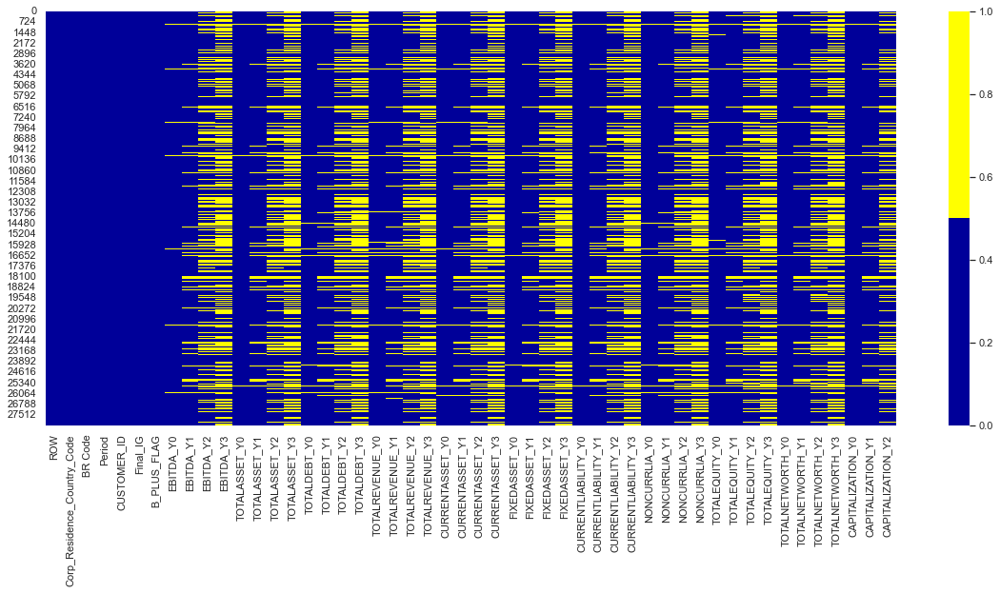

In [27]:
# Look for missing data
cols = df1.columns[:50] # first 50 columns
colours = ['#000099', '#ffff00'] # specify the colours - yellow is missing. blue is not missing.
plt.figure(figsize = (20,8)) 
print("Canadian Companies Missing Values Heatmap:")
sns.heatmap(df1[cols].isnull(), cmap=sns.color_palette(colours))

General Companies Missing Values Heatmap:


<AxesSubplot:>

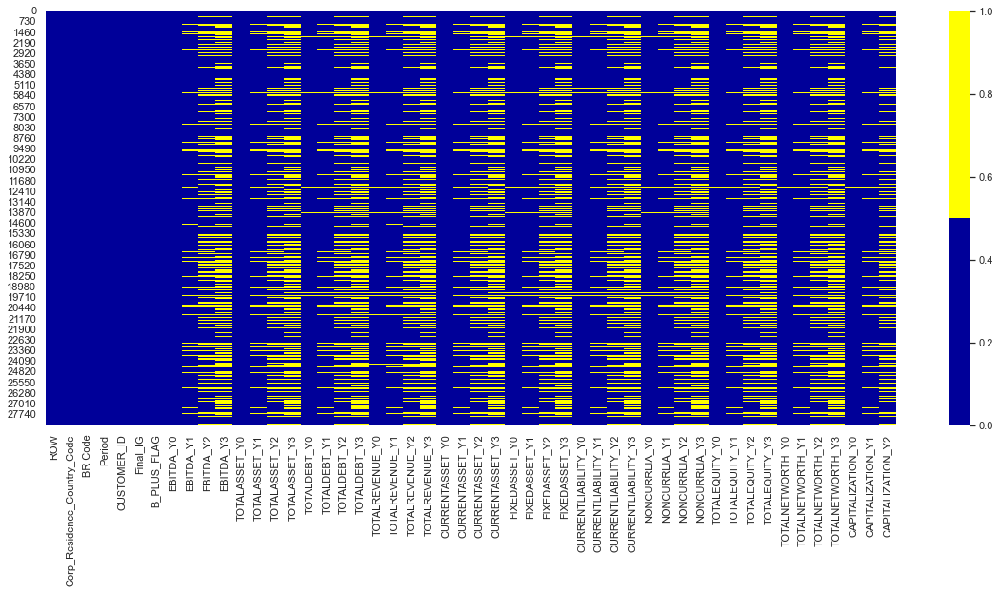

In [28]:
# Look for missing data -- General Companies 
cols = df2.columns[:50] # first 50 columns
colours = ['#000099', '#ffff00'] # specify the colours - yellow is missing. blue is not missing.
plt.figure(figsize = (20,8))
print("General Companies Missing Values Heatmap:")
sns.heatmap(df2[cols].isnull(), cmap=sns.color_palette(colours))

At first galance, we can see that the general companies dataset is missing fewer values than the first one. 

In [29]:
# % of missing.  -- Here we can see how about 30 of the columns are missing 50% or more of their data
hash_tbl = {}
for col in df1.columns:
    pct_missing = np.mean(df1[col].isnull())
    hash_tbl["{}".format(col)] = round(pct_missing*100)
    
print("Percentage of Missing Values in Each Column for Canadian Companies:")
{k: v for k, v in sorted(hash_tbl.items(), key=lambda item: item[1])}

Percentage of Missing Values in Each Column for Canadian Companies:


{'ROW': 0,
 'Corp_Residence_Country_Code': 0,
 'BR Code': 0,
 'Period': 0,
 'CUSTOMER_ID': 0,
 'Final_IG': 0,
 'B_PLUS_FLAG': 0,
 'TOTALASSET_Y0': 1,
 'EBITDA_Y0': 2,
 'FIXEDASSET_Y0': 2,
 'CURRENTLIABILITY_Y0': 2,
 'EBITDAR_Y0': 2,
 'NETPROFIT_Y0': 2,
 'NETSALES_Y0': 2,
 'OPERPROFIT_Y0': 2,
 'TOTALDEBT_Y0': 3,
 'TOTALREVENUE_Y0': 3,
 'CURRENTASSET_Y0': 3,
 'NONCURRLIA_Y0': 3,
 'TOTALEQUITY_Y0': 3,
 'TOTALNETWORTH_Y0': 3,
 'CAPITALIZATION_Y0': 3,
 'TOTINTEXP_Y0': 3,
 'LEASERENTEXP_Y0': 3,
 'tangibleNetWorth_Y0': 3,
 'FIXEDCHARGECOV_Y0': 3,
 'DEBTSERVCOV_Y0': 3,
 'ASSETTURNOVER_Y0': 3,
 'RETAINED_EARNINGS_Y0': 3,
 'receivabledays_Y0': 4,
 'ARTurnover_Y0': 4,
 'Inventory_Y0': 4,
 'CCE_Y0': 4,
 'payableDAYS_Y0': 7,
 'EBITDA_Y1': 8,
 'TOTALASSET_Y1': 8,
 'FIXEDASSET_Y1': 8,
 'CURRENTLIABILITY_Y1': 8,
 'EBITDAR_Y1': 8,
 'NETPROFIT_Y1': 8,
 'OPERPROFIT_Y1': 8,
 'TOTALREVENUE_Y1': 9,
 'CURRENTASSET_Y1': 9,
 'NONCURRLIA_Y1': 9,
 'TOTALNETWORTH_Y1': 9,
 'CAPITALIZATION_Y1': 9,
 'LEASERENTEXP_Y1

In [30]:
# % of missing data for general industries -- We notice that the general companies actually have less missing data
hash_tbl = {}
for col in df2.columns:
    pct_missing = np.mean(df2[col].isnull())
    hash_tbl["{}".format(col)] = round(pct_missing*100)
    
print("Percentage of Missing Values in Each Column for General Companies:")
{k: v for k, v in sorted(hash_tbl.items(), key=lambda item: item[1])}

Percentage of Missing Values in Each Column for General Companies:


{'ROW': 0,
 'Corp_Residence_Country_Code': 0,
 'BR Code': 0,
 'Period': 0,
 'CUSTOMER_ID': 0,
 'Final_IG': 0,
 'B_PLUS_FLAG': 0,
 'EBITDA_Y0': 0,
 'TOTALASSET_Y0': 0,
 'CURRENTASSET_Y0': 0,
 'TOTALEQUITY_Y0': 0,
 'TOTALNETWORTH_Y0': 0,
 'CAPITALIZATION_Y0': 0,
 'EBITDAR_Y0': 0,
 'tangibleNetWorth_Y0': 0,
 'NETPROFIT_Y0': 0,
 'NETSALES_Y0': 0,
 'OPERPROFIT_Y0': 0,
 'TOTALDEBT_Y0': 1,
 'FIXEDASSET_Y0': 1,
 'CURRENTLIABILITY_Y0': 1,
 'NONCURRLIA_Y0': 1,
 'TOTINTEXP_Y0': 1,
 'LEASERENTEXP_Y0': 1,
 'FIXEDCHARGECOV_Y0': 1,
 'DEBTSERVCOV_Y0': 1,
 'RETAINED_EARNINGS_Y0': 1,
 'CCE_Y0': 1,
 'TOTALREVENUE_Y0': 2,
 'receivabledays_Y0': 2,
 'ASSETTURNOVER_Y0': 2,
 'ARTurnover_Y0': 2,
 'INVENTORY_Y0': 2,
 'payableDAYS_Y0': 3,
 'EBITDA_Y1': 7,
 'TOTALASSET_Y1': 7,
 'CURRENTASSET_Y1': 7,
 'CAPITALIZATION_Y1': 7,
 'EBITDAR_Y1': 7,
 'INVENTORYDAYS_Y0': 7,
 'tangibleNetWorth_Y1': 7,
 'NETPROFIT_Y1': 7,
 'NETSALES_Y1': 7,
 'OPERPROFIT_Y1': 7,
 'TOTALDEBT_Y1': 8,
 'FIXEDASSET_Y1': 8,
 'CURRENTLIABILITY_Y1'

In [31]:
# Lets see how many total values are missing
print("Canadian Companies missing Values:", df1.isnull().sum().sum())
print("General Companies missing Values:", df2.isnull().sum().sum()) # About 18k less NA's

Canadian Companies missing Values: 798803
General Companies missing Values: 629385


In [32]:
##Let's look at if unique identifiers are repeated
#If the percentage of a dataset has less than 60% of the values repeated, it will be highlighted
unique_identifiers = ['CUSTOMER_ID','BR Code','Corp_Residence_Country_Code']
dataframes = [df1, df2]
dataframe_names = ['df1','df2']
cutoff = 60

for index, dataframe in enumerate(dataframes):
  print(f'Assessing {dataframe_names[index]}')
  for col in dataframe.columns:
    check_nunique = dataframe[col].nunique()/dataframe[col].count() * 100
    if check_nunique <= cutoff:
      print(f'{check_nunique}% of {col} in {dataframe_names[index]} has unique values')
  print('\n')

Assessing df1
0.010629251700680272% of Corp_Residence_Country_Code in df1 has unique values
0.37556689342403626% of BR Code in df1 has unique values
0.07794784580498866% of Period in df1 has unique values
42.97052154195011% of CUSTOMER_ID in df1 has unique values
0.05668934240362812% of Final_IG in df1 has unique values
0.007086167800453515% of B_PLUS_FLAG in df1 has unique values


Assessing df2
0.27051714446318154% of Corp_Residence_Country_Code in df2 has unique values
0.41104553119730186% of BR Code in df2 has unique values
0.08431703204047217% of Period in df2 has unique values
39.31281618887015% of CUSTOMER_ID in df2 has unique values
0.06323777403035413% of Final_IG in df2 has unique values
0.0070264193367060145% of B_PLUS_FLAG in df2 has unique values




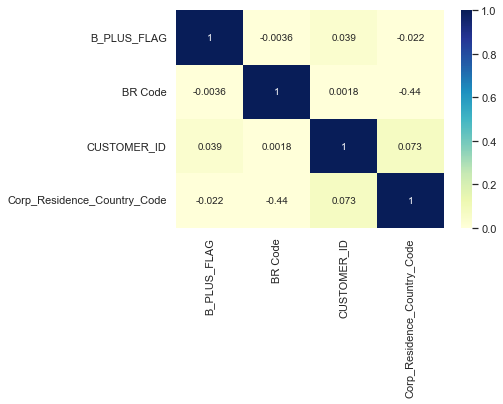

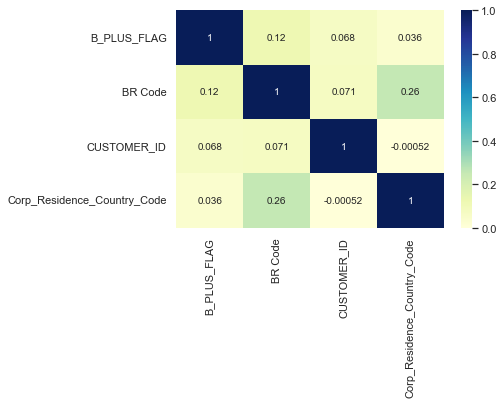

In [33]:
#Lets compare how often these repeated values are classified as a risky investment
#B_PLUS_FLAG '0' is considered a risky investment

dataframes = [df1, df2]
dataframe_names = ['df1','df2']

features = ['B_PLUS_FLAG','BR Code',"CUSTOMER_ID",'Corp_Residence_Country_Code']

#Covariance Matrices Coefficient between B_PLUS_FLAG:
for index, dataframe in enumerate(dataframes):
  data = dataframe.filter(items=features,axis=1)
  normalized_data = (data-data.mean())/data.std() #Mean normalization
  # normalized_data = (data-data.min())/(data.max()-data.min()) #min_max normalization
  dataplot = sns.heatmap(normalized_data.cov(), cmap="YlGnBu", annot=True, vmax=1,vmin=0)
  plt.show()

These results indicate that there is no covariance between any of the repeated features and B_PLUS_FLAG.**However**, because B_PLUS_FLAG is a categorical variable, an ANOVA is required to see the importance of each variable in B_PLUS_FLAG

In [34]:
dataframes = [df1, df2]
dataframe_names = ['df1','df2']

features = ['B_PLUS_FLAG','BR Code',"CUSTOMER_ID",'Corp_Residence_Country_Code']

features_test_df = df1[features]
# features_test_df.set_index('B_PLUS_FLAG', inplace=True)

repeated_customer_IDs = features_test_df.value_counts()
all_customers = []
count_customers = {}
for customer in features_test_df['CUSTOMER_ID']:
  if customer in count_customers.keys():
    count_customers[customer] += 1
  else: count_customers[customer] = 1

repeat_customers = []
for key in count_customers.keys():
  if count_customers[key] > 1:
    repeat_customers.append(key)

repeat_customers.sort()
print(repeat_customers[:20])

[0, 1, 3, 5, 6, 10, 11, 12, 13, 15, 16, 17, 18, 21, 24, 25, 28, 29, 30, 32]


## Data Cleaning Methods <a class="anchor" id="2.2"></a>
### Data Prep -- Column Types, Date Manipulations, Fixing infinity values <a class="anchor" id="2.2.1"></a>


In [35]:
# Fix the object type column to datetime
df1["Date"] = pd.to_datetime(df1.Period)
df2["Date"] = pd.to_datetime(df1.Period)

# Drop the object column
df1 = df1.drop(['Period'], axis=1)
df2 = df2.drop(['Period'], axis=1)
df1.info() # Now we have removed the Object column, and got the date as a datetime column

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28224 entries, 0 to 28223
Columns: 125 entries, ROW to Date
dtypes: datetime64[ns](1), float64(118), int64(6)
memory usage: 26.9 MB


In [36]:
# Extract year and month for df1
df1['Year'] = df1['Date'].dt.year
df1['Month'] = df1['Date'].dt.month

# Do the same for df2
df2['Year'] = df2['Date'].dt.year
df2['Month'] = df2['Date'].dt.month

In [37]:
# Fix the infinity Issues (Some columns have values at infinity -- Fix this )
def impute_inf(data,col):
    #Impute -inf of the column of data as the minimum of the rest
    #Impute inf of the column of data as the maximum of the rest
    data.loc[data[col] == -np.inf, col] = data.loc[(data[col] > -np.inf) & (data[col] < np.inf),col].min()
    data.loc[data[col] == np.inf, col] = data.loc[(data[col] < np.inf) & (data[col] < np.inf),col].max()

    return data

# Replace all -/+ inf values with min and max values of the dataset 
for col in df1.columns:
    if col in ["Date","Period"]: pass
    else: df1 = impute_inf(df1,col)

# Do the same for General Companies 
for col in df2.columns:
    if col in ["Date","Period"]: pass
    else: df2 = impute_inf(df2,col)

In [38]:
df1.head()

,ROW,Corp_Residence_Country_Code,BR Code,CUSTOMER_ID,Final_IG,B_PLUS_FLAG,EBITDA_Y0,EBITDA_Y1,EBITDA_Y2,EBITDA_Y3,TOTALASSET_Y0,TOTALASSET_Y1,TOTALASSET_Y2,TOTALASSET_Y3,TOTALDEBT_Y0,TOTALDEBT_Y1,TOTALDEBT_Y2,TOTALDEBT_Y3,TOTALREVENUE_Y0,TOTALREVENUE_Y1,TOTALREVENUE_Y2,TOTALREVENUE_Y3,CURRENTASSET_Y0,CURRENTASSET_Y1,CURRENTASSET_Y2,CURRENTASSET_Y3,FIXEDASSET_Y0,FIXEDASSET_Y1,FIXEDASSET_Y2,FIXEDASSET_Y3,CURRENTLIABILITY_Y0,CURRENTLIABILITY_Y1,CURRENTLIABILITY_Y2,CURRENTLIABILITY_Y3,NONCURRLIA_Y0,NONCURRLIA_Y1,NONCURRLIA_Y2,NONCURRLIA_Y3,TOTALEQUITY_Y0,TOTALEQUITY_Y1,TOTALEQUITY_Y2,TOTALEQUITY_Y3,TOTALNETWORTH_Y0,TOTALNETWORTH_Y1,TOTALNETWORTH_Y2,TOTALNETWORTH_Y3,CAPITALIZATION_Y0,CAPITALIZATION_Y1,CAPITALIZATION_Y2,CAPITALIZATION_Y3,TOTINTEXP_Y0,TOTINTEXP_Y1,TOTINTEXP_Y2,TOTINTEXP_Y3,LEASERENTEXP_Y0,LEASERENTEXP_Y1,LEASERENTEXP_Y2,LEASERENTEXP_Y3,EBITDAR_Y0,EBITDAR_Y1,EBITDAR_Y2,EBITDAR_Y3,receivabledays_Y0,receivabledays_Y1,receivabledays_Y2,receivabledays_Y3,INVENTORYDAYS_Y0,INVENTORYDAYS_Y1,INVENTORYDAYS_Y2,INVENTORYDAYS_Y3,payableDAYS_Y0,payableDAYS_Y1,payableDAYS_Y2,payableDAYS_Y3,Capex2Dep_Y0,Capex2Dep_Y1,Capex2Dep_Y2,tangibleNetWorth_Y0,tangibleNetWorth_Y1,tangibleNetWorth_Y2,tangibleNetWorth_Y3,FIXEDCHARGECOV_Y0,FIXEDCHARGECOV_Y1,FIXEDCHARGECOV_Y2,FIXEDCHARGECOV_Y3,DEBTSERVCOV_Y0,DEBTSERVCOV_Y1,DEBTSERVCOV_Y2,DEBTSERVCOV_Y3,NETPROFIT_Y0,NETPROFIT_Y1,NETPROFIT_Y2,NETPROFIT_Y3,NETSALES_Y0,NETSALES_Y1,NETSALES_Y2,NETSALES_Y3,ASSETTURNOVER_Y0,ASSETTURNOVER_Y1,ASSETTURNOVER_Y2,ASSETTURNOVER_Y3,OPERPROFIT_Y0,OPERPROFIT_Y1,OPERPROFIT_Y2,OPERPROFIT_Y3,ARTurnover_Y0,ARTurnover_Y1,ARTurnover_Y2,ARTurnover_Y3,Inventory_Y0,Inventory_Y1,Inventory_Y2,Inventory_Y3,RETAINED_EARNINGS_Y0,RETAINED_EARNINGS_Y1,RETAINED_EARNINGS_Y2,RETAINED_EARNINGS_Y3,FCF_Y0,FCF_Y1,FCF_Y2,CCE_Y0,CCE_Y1,CCE_Y2,CCE_Y3,Date,Year,Month
0,5662,1,5,1576,5,1,575863.911214,602838.635998,583646.469630,614602.866245,619611.510181,621095.725446,611355.907673,582433.004400,623105.791017,596800.177680,600460.033208,598408.339905,611355.411490,589592.109008,605336.777910,574789.603998,620745.952718,621004.600446,614991.732391,604478.517167,609095.636450,600147.701765,589971.619360,580405.105567,578103.988392,577109.531117,574090.626783,583030.371565,600890.935743,604975.472270,600103.052065,601804.995337,596259.219747,573227.115787,572126.125957,601814.939331,578045.252633,571339.795861,596653.190112,590035.602606,571736.508285,628719.211745,584338.549368,616858.074405,611986.404942,604922.163814,577051.576457,613092.388218,603141.577521,576650.299516,620686.247107,610847.649882,585871.251511,616877.792537,568949.503421,618110.180319,604601.169985,580153.927795,590842.797526,590664.224219,590472.808115,616986.562624,572661.424837,574363.146314,582917.058057,583420.366083,607467.206600,583658.695782,603769.043190,601041.664461,590112.115029,590316.935078,602489.197881,607756.994574,602468.604889,579949.325730,585896.605197,615126.516293,604036.179493,573565.511062,607130.118230,571946.940867,592574.187811,623675.986993,618944.803911,580343.279228,590502.807033,609912.733618,599498.344764,595156.410271,587134.042491,570091.364648,580823.373014,608524.711934,622059.106399,575870.723892,573508.493635,570519.450943,608807.689045,593269.795473,599593.828998,621562.468837,588906.640575,600112.382878,626071.057035,591870.004065,588954.39502,604537.606945,597031.247138,600893.706501,590802.111805,606861.990009,570523.662855,NaN,575350.400174,571025.770698,603242.309649,622846.821734,2017-10-01,2017,10
1,16369,1,5,4545,7,1,599469.364624,615373.028208,612705.047096,NaN,608126.531748,601435.154115,587550.520995,NaN,627335.355343,611300.879046,572542.268654,NaN,604626.757034,586282.226249,624691.726730,NaN,596315.871786,609786.889797,620321.870767,NaN,577715.935070,576662.704616,582062.515093,NaN,616376.771099,604827.131130,599463.087501,NaN,584268.408156,615338.209036,617623.837767,NaN,599915.942888,587706.105861,595274.082521,NaN,575278.320599,612795.138987,582300.999226,NaN,58617

### Missing Values - Simple Imputer (Mean, Median, Mode, Constant) <a class="anchor" id="2.2.2"></a>

In [29]:
# Remove rows which are missing 25% or more of the data
# Keep track of the rows with missing values
index_list=[]
for i in range(len(df1.index)):
    missing_values_per_row = df1.iloc[i].isnull().sum()
    if missing_values_per_row > 30:
        index_list.append(i)
        
print("Canadian Companies before dropping rows:", df1.shape)
df1.drop(df1.index[index_list], inplace=True)
print("After dropping rows missing 25% of data or more:", df1.shape)

Canadian Companies before dropping rows: (28224, 127)
After dropping rows missing 25% of data or more: (17662, 127)


In [30]:
# Do the same for Df2
index_list=[]
for i in range(len(df2.index)):
    missing_values_per_row = df2.iloc[i].isnull().sum()
    if missing_values_per_row > 30:
        index_list.append(i)
        
print("General Companies before dropping rows:", df2.shape)
df2.drop(df2.index[index_list], inplace=True)
print("After dropping rows missing 25% of data or more:", df2.shape)

General Companies before dropping rows: (28464, 127)
After dropping rows missing 25% of data or more: (20399, 127)


In [31]:
def avg_num_missing_values(df):
  missing_values_per_row_lst = [] 
  for i in range(len(df.index)):
    missing_values_per_row_lst.append(df.iloc[i].isnull().sum())
  return np.mean(missing_values_per_row_lst)

In [32]:
# How many values are missing on average / row?
avg_num_missing_values(df1)

7.736043483184237

In [33]:
# How many values are missing on average / row?
avg_num_missing_values(df2)

5.88587675866464

####  Average Missing Values / Row
Thus, on average, each row in the Canadian Companies dataset is missing about 8 values / 127 columns. <br>
Furthermore, General Companies Dataset is only missing 6 values / row on average. <br> 
Thus, we can really just impute the remaining values.

Ways we tried: <br> 
Replace the rest with mean <br>
Replace the rest with median <br>
Replace the rest with Random Imputation <br>
Replace the financial columns / growth columns with previous years value <br>
Replace it with the 3 years average column <br>
Replace the rest with complex imputer (SR Imputation, Complex Iterative Imputer - KNN, etc.)<br>

In [34]:
import math
import copy
from sklearn import linear_model
from sklearn.ensemble import RandomForestClassifier
from sklearn.impute import SimpleImputer
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.pipeline import Pipeline

In [39]:
def missing_columns_func(df):
  """Returns a list of the features with missing data in a dataset"""
  missing_columns = []
  for feature in df:
    if df[feature].isna().sum() > 0: 
      missing_columns.append(feature)
  return missing_columns

def missing_columns_to_impute_func(df):
  """Returns a list of the features with missing data in a dataset for which are to be imputed on"""
  #Identify which columns need to be imputed
  fin_features_lst = fin_features_func(df)
  remove_features_lst = list(set(df.columns[:]) - set(fin_features_lst)) #Removes the non-financial features so that the regression does not use those values
  try: remove_features_lst.append('RATING_SAVE_DATE') #Hardcoded
  except: pass
  missing_columns_to_impute = missing_columns_func(df)
  for remove_feature in remove_features_lst:
    try: missing_columns_to_impute.remove(remove_feature)
    except: continue
  return missing_columns_to_impute

def fin_features_func(df):
  """Returns a list of the financial features identified in the dataset by assaying if specific key words are present in the feature's descriptions"""
  fin_features = []
  key_words = ['rating','ebitda','debt','revenue','asset','liabilit', 'equit', 'worth','capital','expense','interest','receivable','invent','payable','coverage','profit','turnover','cash','sale','earning']
  key_word_min = min(key_words, key=len)
  exclude_words = ['date']
  for index, row in data_dictionary.iterrows():
    found = False
    for feature_word in row["Description"].split(' '):
      if found == True: break #Break the loop if a financial word was found. Speeds up process
      if len(feature_word) < len(key_word_min): continue #If the word being looked at is smaller than the smallest word in the key_words list, stop and go to the next word
      for index,key_word in enumerate(key_words):
        if key_word.lower() in feature_word.lower():
          found = True
          fin_features.append(row["Column"])
          break
  return fin_features

In [45]:
# # Essentially we are filling every column with it's grouped ID's average value per column. 
def impute_average_and_constant(data,group = 'CUSTOMER_ID',constant = 0):
  """This will impute the missing values by grouping the dataset based on a shared value in a column. 
  If no groups can be made (i.e. only one dataset in a group, then the missing data will be imputed with a constant.
  
  data - the data table to be imputed on. Type = pandas dataframe
  group - the column to group by. Default is CUSTOMER_ID
  constant - the constant to impute any data that cannot be grouped. Default is 0
  
  """
  for col in data.columns:
    data[col] = data.groupby('CUSTOMER_ID')[col].apply(lambda x:x.fillna(x.mean()))

  data = data.fillna(constant)
  return data

In [46]:
dataframes = [df1, df1]
dataframes_name = ['df1','df2']

for index, dataframe in enumerate(dataframes):
  print('Cross validating with simple imputers using Random Forect with: ',dataframes_name[index])
  data = copy.deepcopy(dataframe)
  data.head()
  missing_columns_to_impute = missing_columns_to_impute_func(data)
  X, y = data[missing_columns_to_impute], data['B_PLUS_FLAG'] # NOTE: B_PLUS_FLAG is the target variable

  # evaluate each strategy on the dataset
  results = []
  strategies = ['mean', 'median', 'most_frequent', 'constant']
  for s in strategies:
    # create the modeling pipeline
    pipeline = Pipeline(steps=[('i', SimpleImputer(strategy=s)), ('m', RandomForestClassifier())])
    # evaluate the model
    cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
    scores = cross_val_score(pipeline, X, y, scoring='accuracy', cv=cv, n_jobs=-1)
    # store results
    results.append(scores)
    print('>%s %.3f (%.3f)' % (s, np.mean(scores), np.std(scores)))

  # # Essentially we are filling every column with it's grouped ID's average value per column. 
  data = impute_average_and_constant(data)

  X, y = data[missing_columns_to_impute], data['B_PLUS_FLAG']
  # create the modeling pipeline
  pipeline = Pipeline(steps=[('i', SimpleImputer(strategy=s)), ('m', RandomForestClassifier())])
  # evaluate the model
  cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
  scores = cross_val_score(pipeline, X, y, scoring='accuracy', cv=cv, n_jobs=-1)
  # store results
  results.append(scores) 
  print('>mean by Customer ID + Constant %.3f (%.3f)' % (np.mean(scores), np.std(scores)))

  strategies.append('mean + Constant')

  # plot model performance for comparison
  plt.boxplot(results, labels=strategies, showmeans=True)
  plt.show()

Cross validating with simple imputers using Random Forect with:  df1


NameError: name 'copy' is not defined

In [42]:
# df1_EDA = ProfileReport(df1, title="Canadian Companies Report", minimal=True)
# df1_EDA

### Three Year Average <a class="anchor" id="2.2.3"></a>

In [39]:
def three_year_average(X,col_y0,col_y1,col_y2,col):
  X.drop(X[X[col_y0].isnull()].index, inplace = True)
  #Remove those records if the first year financial info is not available

  two_years_average = X[col_y1].notnull() & X[col_y2].isnull()
  X.loc[two_years_average, col] = X.loc[two_years_average,col_y0] * 4/7 + X.loc[two_years_average,col_y1] * 3/7

  three_years_average = X[col_y1].notnull() & X[col_y2].notnull()
  X.loc[three_years_average, col] = X.loc[three_years_average,col_y0] * 4/9 + X.loc[three_years_average,col_y1] * 3/9 + X.loc[three_years_average,col_y2] * 2/9

  return X

**Please note that the below code ONLY tests Random Forest using the data that was averaged across 3 years, and tests it with the B-Plus_Flag target. All other features like year or country code are not present.**

>mean 0.861 (0.001)
>median 0.861 (0.001)
>most_frequent 0.861 (0.002)
>constant 0.861 (0.001)


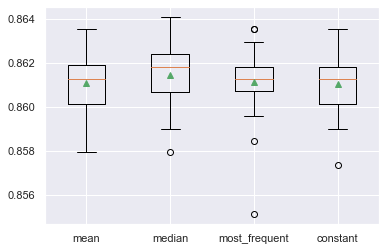

In [40]:
data_3Y = copy.deepcopy(df1)

columns = list(data_3Y.columns)
year_list = ['_Y0','_Y1','_Y2','_Y3']
year_dictionary = {}
year_dictionary['Features'] = []
for year in year_list:
  year_dictionary[year] = []
  for col in columns:
    if year in col: 
      year_dictionary[year].append(col) #Separates out the features based on year (purpose = organization)
      if col[:-3] not in year_dictionary['Features']:
        year_dictionary['Features'].append(col[:-3])


missing_columns_to_impute = year_dictionary['_Y0'] + year_dictionary['_Y1'] + year_dictionary['_Y2']
X, y = data[missing_columns_to_impute], data['B_PLUS_FLAG'] # NOTE: B_PLUS_FLAG is the target variable
# evaluate each strategy on the dataset
results = []
strategies = ['mean', 'median', 'most_frequent', 'constant']
for s in strategies:
  X_imputed = X[:] #Create a copy to test the different strategies, without altering the original dataset
  imputed = SimpleImputer(strategy = s)
  X_imputed[:] = imputed.fit_transform(X)

  #Build the new dataset using three year averages
  cols_to_avg = []
  for col in year_dictionary['Features']:
    cols_to_avg.append([col + '_Y0', col + '_Y1', col + '_Y2', col + '_3YearAverage'])
  
  for col1, col2, col3, col in cols_to_avg:
    averaged_X_imputed = three_year_average(X_imputed, col1, col2, col3, col)
  
  #Remove all features that do not contain "_3YearAverage" tag
  processed_X = averaged_X_imputed.filter(like = "_3YearAverage", axis = 1)

  # create the modeling pipeline
  pipeline = Pipeline(steps=[('m', RandomForestClassifier())])
#   # evaluate the model
  cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
  scores = cross_val_score(pipeline, processed_X, y, scoring='accuracy', cv=cv, n_jobs=-1)
  # store results
  results.append(scores)
  print('>%s %.3f (%.3f)' % (s, np.mean(scores), np.std(scores)))
# plot model performance for comparison
plt.boxplot(results, labels=strategies, showmeans=True)
plt.show()


### Missing Values - Complex Imputer (Stochastic Regression)<a class="anchor" id="2.2.4"></a>

In [41]:
def random_imputation(df, feature):
  """replaces the missing values with some random observed values of the variable. 
  The method is repeated for all the variables containing missing values, after 
  which they serve as parameters in the regression model to estimate other variable values."""
  number_missing = df[feature].isnull().sum()
  observed_values = df.loc[df[feature].notnull(), feature]
  df.loc[df[feature].isnull(), feature + '_imp'] = np.random.choice(observed_values, number_missing, replace = True)
  return df


In [42]:
def data_imputed_dataframe_func(df):
  #Identify which columns need to be imputed
  missing_columns_to_impute = missing_columns_to_impute_func(df)

  #Generate a dataframe with imputed values randomly allocated from another item of the same feature
  data_imputed = df[missing_columns_to_impute].copy()
  for feature in missing_columns_to_impute[:]:
      data_imputed[feature + '_imp'] = df[feature] #To separate the imputed data from the original data set, to maintain the original values
      data_imputed = random_imputation(data_imputed, feature)

  return data_imputed, missing_columns_to_impute

def deterministic_regression_func(df):
  #Generate the initial dataframe to impute off of, and identify which columns to run the regression on
  data_imputed = data_imputed_dataframe_func(df)[0]
  missing_columns_to_impute = data_imputed_dataframe_func(df)[1] 
  
  #Imputed based on deterministic regression
  deterministic_regression_data = pd.DataFrame(columns = ["Det." + name for name in missing_columns_to_impute])

  for feature in missing_columns_to_impute:
      deterministic_regression_data["Det." + feature] = data_imputed[feature + "_imp"]
      parameters = list(set(data_imputed.columns) - set(missing_columns_to_impute) - {feature + '_imp'})

      #Create a Linear Regression model to estimate the missing data
      model = linear_model.LinearRegression(positive = True)
      model.fit(X = data_imputed[parameters], y = data_imputed[feature + '_imp'])

      #The index of the missing data is preserved from the original dataframe
      deterministic_regression_data.loc[data_imputed[feature].isnull(), "Det." + feature] = model.predict(data_imputed[parameters])[data_imputed[feature].isnull()]
  
  return deterministic_regression_data

def stochastic_regression_func(df):
  #Generate the initial dataframe to impute off of, and identify which columns to run the regression on
  data_imputed = data_imputed_dataframe_func(df)[0]
  missing_columns_to_impute = data_imputed_dataframe_func(df)[1] 

  #Imputed based on stochastic regression
  stochastic_regression_data = pd.DataFrame(columns = ["Stoch." + name for name in missing_columns_to_impute])

  
  for feature in missing_columns_to_impute:

    stochastic_regression_data["Stoch." + feature] = data_imputed[feature + '_imp']
    parameters = list(set(data_imputed.columns) - set(missing_columns_to_impute) - {feature + '_imp'})

    #Create a Linear Regression model to estimate the missing data    
    model = linear_model.LinearRegression()
    model.fit(X = data_imputed[parameters], y = data_imputed[feature + '_imp'])
    
    #Standard Error of the regression estimates is equal to std() of the errors of each estimates
    predict = model.predict(data_imputed[parameters])
    std_error = (predict[data_imputed[feature].notnull()] - data_imputed.loc[data_imputed[feature].notnull(), feature + '_imp']).std()
    
    #The index of the missing data is preserved from the original dataframe
    random_predict = np.random.normal(size = data_imputed[feature].shape[0], loc = predict, scale = std_error)
    stochastic_regression_data.loc[(data_imputed[feature].isnull()) & (random_predict > 0), "Stoch." + feature] = random_predict[(data_imputed[feature].isnull()) & (random_predict > 0)]
  return stochastic_regression_data

In [43]:
# Deterministic regression of df1
det_reg_imputed_df1 = deterministic_regression_func(df1)
det_reg_imputed_df1.head()

,Det.EBITDA_Y0,Det.EBITDA_Y1,Det.EBITDA_Y2,Det.EBITDA_Y3,Det.TOTALASSET_Y0,Det.TOTALASSET_Y1,Det.TOTALASSET_Y2,Det.TOTALASSET_Y3,Det.TOTALDEBT_Y0,Det.TOTALDEBT_Y1,Det.TOTALDEBT_Y2,Det.TOTALDEBT_Y3,Det.TOTALREVENUE_Y0,Det.TOTALREVENUE_Y1,Det.TOTALREVENUE_Y2,Det.TOTALREVENUE_Y3,Det.CURRENTASSET_Y0,Det.CURRENTASSET_Y1,Det.CURRENTASSET_Y2,Det.CURRENTASSET_Y3,Det.FIXEDASSET_Y0,Det.FIXEDASSET_Y1,Det.FIXEDASSET_Y2,Det.FIXEDASSET_Y3,Det.CURRENTLIABILITY_Y0,Det.CURRENTLIABILITY_Y1,Det.CURRENTLIABILITY_Y2,Det.CURRENTLIABILITY_Y3,Det.NONCURRLIA_Y0,Det.NONCURRLIA_Y1,Det.NONCURRLIA_Y2,Det.NONCURRLIA_Y3,Det.TOTALEQUITY_Y0,Det.TOTALEQUITY_Y1,Det.TOTALEQUITY_Y2,Det.TOTALEQUITY_Y3,Det.TOTALNETWORTH_Y0,Det.TOTALNETWORTH_Y1,Det.TOTALNETWORTH_Y2,Det.TOTALNETWORTH_Y3,Det.CAPITALIZATION_Y0,Det.CAPITALIZATION_Y1,Det.CAPITALIZATION_Y2,Det.CAPITALIZATION_Y3,Det.TOTINTEXP_Y0,Det.TOTINTEXP_Y1,Det.TOTINTEXP_Y2,Det.TOTINTEXP_Y3,Det.LEASERENTEXP_Y0,Det.LEASERENTEXP_Y1,Det.LEASERENTEXP_Y2,Det.LEASERENTEXP_Y3,Det.EBITDAR_Y0,Det.EBITDAR_Y1,Det.EBITDAR_Y2,Det.EBITDAR_Y3,Det.receivabledays_Y0,Det.receivabledays_Y1,Det.receivabledays_Y2,Det.receivabledays_Y3,Det.INVENTORYDAYS_Y0,Det.INVENTORYDAYS_Y1,Det.INVENTORYDAYS_Y2,Det.INVENTORYDAYS_Y3,Det.payableDAYS_Y0,Det.payableDAYS_Y1,Det.payableDAYS_Y2,Det.payableDAYS_Y3,Det.Capex2Dep_Y0,Det.Capex2Dep_Y1,Det.Capex2Dep_Y2,Det.tangibleNetWorth_Y0,Det.tangibleNetWorth_Y1,Det.tangibleNetWorth_Y2,Det.tangibleNetWorth_Y3,Det.FIXEDCHARGECOV_Y0,Det.FIXEDCHARGECOV_Y1,Det.FIXEDCHARGECOV_Y2,Det.FIXEDCHARGECOV_Y3,Det.DEBTSERVCOV_Y0,Det.DEBTSERVCOV_Y1,Det.DEBTSERVCOV_Y2,Det.DEBTSERVCOV_Y3,Det.NETPROFIT_Y0,Det.NETPROFIT_Y1,Det.NETPROFIT_Y2,Det.NETPROFIT_Y3,Det.NETSALES_Y0,Det.NETSALES_Y1,Det.NETSALES_Y2,Det.NETSALES_Y3,Det.ASSETTURNOVER_Y0,Det.ASSETTURNOVER_Y1,Det.ASSETTURNOVER_Y2,Det.ASSETTURNOVER_Y3,Det.OPERPROFIT_Y0,Det.OPERPROFIT_Y1,Det.OPERPROFIT_Y2,Det.OPERPROFIT_Y3,Det.ARTurnover_Y0,Det.ARTurnover_Y1,Det.ARTurnover_Y2,Det.ARTurnover_Y3,Det.Inventory_Y0,Det.Inventory_Y1,Det.Inventory_Y2,Det.Inventory_Y3,Det.RETAINED_EARNINGS_Y0,Det.RETAINED_EARNINGS_Y1,Det.RETAINED_EARNINGS_Y2,Det.RETAINED_EARNINGS_Y3,Det.FCF_Y0,Det.FCF_Y1,Det.FCF_Y2,Det.CCE_Y0,Det.CCE_Y1,Det.CCE_Y2,Det.CCE_Y3
0,575863.911214,602838.635998,583646.469630,614602.866245,619611.510181,621095.725446,611355.907673,582433.004400,623105.791017,596800.177680,600460.033208,598408.339905,611355.411490,589592.109008,605336.777910,574789.603998,620745.952718,621004.600446,614991.732391,604478.517167,609095.636450,600147.701765,589971.619360,580405.105567,578103.988392,577109.531117,574090.626783,583030.371565,600890.935743,604975.472270,600103.052065,601804.995337,596259.219747,573227.115787,572126.125957,601814.939331,578045.252633,571339.795861,596653.190112,590035.602606,571736.508285,628719.211745,584338.549368,616858.074405,611986.404942,604922.163814,577051.576457,613092.388218,603141.577521,576650.299516,620686.247107,610847.649882,585871.251511,616877.792537,568949.503421,618110.180319,604601.169985,580153.927795,590842.797526,590664.224219,590472.808115,616986.562624,5.726614e+05,574363.146314,582917.058057,583420.366083,6.074672e+05,583658.695782,603769.043190,601041.664461,590112.115029,590316.935078,602489.197881,607756.994574,602468.604889,579949.325730,585896.605197,615126.516293,604036.179493,573565.511062,607130.118230,571946.940867,592574.187811,623675.986993,618944.803911,580343.279228,590502.807033,609912.733618,599498.344764,595156.410271,587134.042491,570091.364648,580823.373014,608524.711934,622059.106399,575870.723892,573508.493635,570519.450943,608807.689045,593269.795473,599593.828998,621562.468837,588906.640575,600112.382878,626071.057035,591870.004065,588954.395020,604537.606945,597031.247138,600893.706501,590802.111805,606861.990009,570523.662855,575349.766335,575350.400174,571025.770698,603242.309649,622846.821734
3,585059.299344,581915.869330,594033.887481,609965.034011,591791.219692,598332.776102,589877.849288,622230.836194,584513.060799,626

In [44]:
#Deterministic regression of df2
det_reg_imputed_df2 = deterministic_regression_func(df2)
det_reg_imputed_df2.head()

,Det.EBITDA_Y1,Det.EBITDA_Y2,Det.EBITDA_Y3,Det.TOTALASSET_Y0,Det.TOTALASSET_Y1,Det.TOTALASSET_Y2,Det.TOTALASSET_Y3,Det.TOTALDEBT_Y0,Det.TOTALDEBT_Y1,Det.TOTALDEBT_Y2,Det.TOTALDEBT_Y3,Det.TOTALREVENUE_Y0,Det.TOTALREVENUE_Y1,Det.TOTALREVENUE_Y2,Det.TOTALREVENUE_Y3,Det.CURRENTASSET_Y0,Det.CURRENTASSET_Y1,Det.CURRENTASSET_Y2,Det.CURRENTASSET_Y3,Det.FIXEDASSET_Y0,Det.FIXEDASSET_Y1,Det.FIXEDASSET_Y2,Det.FIXEDASSET_Y3,Det.CURRENTLIABILITY_Y0,Det.CURRENTLIABILITY_Y1,Det.CURRENTLIABILITY_Y2,Det.CURRENTLIABILITY_Y3,Det.NONCURRLIA_Y0,Det.NONCURRLIA_Y1,Det.NONCURRLIA_Y2,Det.NONCURRLIA_Y3,Det.TOTALEQUITY_Y0,Det.TOTALEQUITY_Y1,Det.TOTALEQUITY_Y2,Det.TOTALEQUITY_Y3,Det.TOTALNETWORTH_Y0,Det.TOTALNETWORTH_Y1,Det.TOTALNETWORTH_Y2,Det.TOTALNETWORTH_Y3,Det.CAPITALIZATION_Y0,Det.CAPITALIZATION_Y1,Det.CAPITALIZATION_Y2,Det.CAPITALIZATION_Y3,Det.TOTINTEXP_Y0,Det.TOTINTEXP_Y1,Det.TOTINTEXP_Y2,Det.TOTINTEXP_Y3,Det.LEASERENTEXP_Y0,Det.LEASERENTEXP_Y1,Det.LEASERENTEXP_Y2,Det.LEASERENTEXP_Y3,Det.EBITDAR_Y1,Det.EBITDAR_Y2,Det.EBITDAR_Y3,Det.receivabledays_Y0,Det.receivabledays_Y1,Det.receivabledays_Y2,Det.receivabledays_Y3,Det.INVENTORYDAYS_Y0,Det.INVENTORYDAYS_Y1,Det.INVENTORYDAYS_Y2,Det.INVENTORYDAYS_Y3,Det.payableDAYS_Y0,Det.payableDAYS_Y1,Det.payableDAYS_Y2,Det.payableDAYS_Y3,Det.Capex2Dep_Y0,Det.Capex2Dep_Y1,Det.Capex2Dep_Y2,Det.tangibleNetWorth_Y1,Det.tangibleNetWorth_Y2,Det.tangibleNetWorth_Y3,Det.FIXEDCHARGECOV_Y0,Det.FIXEDCHARGECOV_Y1,Det.FIXEDCHARGECOV_Y2,Det.FIXEDCHARGECOV_Y3,Det.DEBTSERVCOV_Y0,Det.DEBTSERVCOV_Y1,Det.DEBTSERVCOV_Y2,Det.DEBTSERVCOV_Y3,Det.NETPROFIT_Y1,Det.NETPROFIT_Y2,Det.NETPROFIT_Y3,Det.NETSALES_Y1,Det.NETSALES_Y2,Det.NETSALES_Y3,Det.ASSETTURNOVER_Y0,Det.ASSETTURNOVER_Y1,Det.ASSETTURNOVER_Y2,Det.ASSETTURNOVER_Y3,Det.OPERPROFIT_Y1,Det.OPERPROFIT_Y2,Det.OPERPROFIT_Y3,Det.ARTurnover_Y0,Det.ARTurnover_Y1,Det.ARTurnover_Y2,Det.ARTurnover_Y3,Det.RETAINED_EARNINGS_Y0,Det.RETAINED_EARNINGS_Y1,Det.RETAINED_EARNINGS_Y2,Det.RETAINED_EARNINGS_Y3,Det.FCF_Y0,Det.FCF_Y1,Det.FCF_Y2,Det.CCE_Y0,Det.CCE_Y1,Det.CCE_Y2,Det.CCE_Y3
0,341575.264490,368053.254720,370696.187829,3.706175e+05,3.497885e+05,3.485696e+05,3.757753e+05,3.755110e+05,3.726001e+05,3.606447e+05,3.735396e+05,3.560748e+05,3.633396e+05,3.585169e+05,3.715991e+05,3.434351e+05,344977.126649,367162.335140,349945.750055,3.784293e+05,3.720962e+05,3.688327e+05,3.472348e+05,355541.904130,367439.639625,340433.991591,367150.907129,3.534059e+05,3.557170e+05,3.530858e+05,3.409601e+05,3.533652e+05,3.479149e+05,3.692967e+05,3.636268e+05,3.700049e+05,3.514704e+05,3.668692e+05,3.436602e+05,3.697346e+05,3.551172e+05,3.435738e+05,3.563240e+05,370169.540410,344003.480397,369171.604555,367363.465248,370634.594885,374281.413522,363411.986740,362056.093767,357961.987189,361050.670507,358189.894815,350879.117221,347265.348459,364929.687159,363903.150704,-956428.717355,-1.938888e+06,344807.527334,2.291225e+06,5.586397e+06,-6.320009e+06,343346.372212,2.457828e+06,362221.588737,340686.574830,362774.829776,349900.900026,367354.207877,346292.283689,351706.612676,9.635352e+08,-9.887303e+08,-1.040335e+09,359576.687007,9.535049e+08,-9.712235e+08,-9.506608e+08,361456.227063,342201.418226,348199.125611,3.516364e+05,3.525602e+05,3.419070e+05,356742.394668,357520.549624,365255.341936,371843.335476,343724.025034,362427.966074,349247.377743,362545.867031,345369.766302,367117.355311,359257.262084,362362.077598,373864.705143,369694.522194,339867.222381,364236.569625,-713644.559838,-592695.526218,350599.333501,368971.137940,342125.692144,360512.171013
1,593272.587785,606298.959960,509377.247299,3.569760e+06,2.232579e+06,2.209726e+06,1.892110e+06,2.179446e+06,1.022687e+06,1.061187e+06,1.032433e+06,1.522408e+06,1.327851e+06,1.280758e+06,1.135047e+06,1.147513e+06,829702.295435,760807.341039,848280.904223,2.716973e+06,1.640463e+06,1.751083e+06,1.379226e+06,644352.547945,487669.347380,497662.519665,481394.063071,2.395843e+06,1.201515e+06,1.199559e+06,1.092157e+06,1.555716e+06,1.472948e+06,1.832633e+06,1.781397e+06,1.558691e+06

In [45]:
# Stochastic Regression for df1
stoch_reg_imputed_df1 = stochastic_regression_func(df1)
stoch_reg_imputed_df1.head()

,Stoch.EBITDA_Y0,Stoch.EBITDA_Y1,Stoch.EBITDA_Y2,Stoch.EBITDA_Y3,Stoch.TOTALASSET_Y0,Stoch.TOTALASSET_Y1,Stoch.TOTALASSET_Y2,Stoch.TOTALASSET_Y3,Stoch.TOTALDEBT_Y0,Stoch.TOTALDEBT_Y1,Stoch.TOTALDEBT_Y2,Stoch.TOTALDEBT_Y3,Stoch.TOTALREVENUE_Y0,Stoch.TOTALREVENUE_Y1,Stoch.TOTALREVENUE_Y2,Stoch.TOTALREVENUE_Y3,Stoch.CURRENTASSET_Y0,Stoch.CURRENTASSET_Y1,Stoch.CURRENTASSET_Y2,Stoch.CURRENTASSET_Y3,Stoch.FIXEDASSET_Y0,Stoch.FIXEDASSET_Y1,Stoch.FIXEDASSET_Y2,Stoch.FIXEDASSET_Y3,Stoch.CURRENTLIABILITY_Y0,Stoch.CURRENTLIABILITY_Y1,Stoch.CURRENTLIABILITY_Y2,Stoch.CURRENTLIABILITY_Y3,Stoch.NONCURRLIA_Y0,Stoch.NONCURRLIA_Y1,Stoch.NONCURRLIA_Y2,Stoch.NONCURRLIA_Y3,Stoch.TOTALEQUITY_Y0,Stoch.TOTALEQUITY_Y1,Stoch.TOTALEQUITY_Y2,Stoch.TOTALEQUITY_Y3,Stoch.TOTALNETWORTH_Y0,Stoch.TOTALNETWORTH_Y1,Stoch.TOTALNETWORTH_Y2,Stoch.TOTALNETWORTH_Y3,Stoch.CAPITALIZATION_Y0,Stoch.CAPITALIZATION_Y1,Stoch.CAPITALIZATION_Y2,Stoch.CAPITALIZATION_Y3,Stoch.TOTINTEXP_Y0,Stoch.TOTINTEXP_Y1,Stoch.TOTINTEXP_Y2,Stoch.TOTINTEXP_Y3,Stoch.LEASERENTEXP_Y0,Stoch.LEASERENTEXP_Y1,Stoch.LEASERENTEXP_Y2,Stoch.LEASERENTEXP_Y3,Stoch.EBITDAR_Y0,Stoch.EBITDAR_Y1,Stoch.EBITDAR_Y2,Stoch.EBITDAR_Y3,Stoch.receivabledays_Y0,Stoch.receivabledays_Y1,Stoch.receivabledays_Y2,Stoch.receivabledays_Y3,Stoch.INVENTORYDAYS_Y0,Stoch.INVENTORYDAYS_Y1,Stoch.INVENTORYDAYS_Y2,Stoch.INVENTORYDAYS_Y3,Stoch.payableDAYS_Y0,Stoch.payableDAYS_Y1,Stoch.payableDAYS_Y2,Stoch.payableDAYS_Y3,Stoch.Capex2Dep_Y0,Stoch.Capex2Dep_Y1,Stoch.Capex2Dep_Y2,Stoch.tangibleNetWorth_Y0,Stoch.tangibleNetWorth_Y1,Stoch.tangibleNetWorth_Y2,Stoch.tangibleNetWorth_Y3,Stoch.FIXEDCHARGECOV_Y0,Stoch.FIXEDCHARGECOV_Y1,Stoch.FIXEDCHARGECOV_Y2,Stoch.FIXEDCHARGECOV_Y3,Stoch.DEBTSERVCOV_Y0,Stoch.DEBTSERVCOV_Y1,Stoch.DEBTSERVCOV_Y2,Stoch.DEBTSERVCOV_Y3,Stoch.NETPROFIT_Y0,Stoch.NETPROFIT_Y1,Stoch.NETPROFIT_Y2,Stoch.NETPROFIT_Y3,Stoch.NETSALES_Y0,Stoch.NETSALES_Y1,Stoch.NETSALES_Y2,Stoch.NETSALES_Y3,Stoch.ASSETTURNOVER_Y0,Stoch.ASSETTURNOVER_Y1,Stoch.ASSETTURNOVER_Y2,Stoch.ASSETTURNOVER_Y3,Stoch.OPERPROFIT_Y0,Stoch.OPERPROFIT_Y1,Stoch.OPERPROFIT_Y2,Stoch.OPERPROFIT_Y3,Stoch.ARTurnover_Y0,Stoch.ARTurnover_Y1,Stoch.ARTurnover_Y2,Stoch.ARTurnover_Y3,Stoch.Inventory_Y0,Stoch.Inventory_Y1,Stoch.Inventory_Y2,Stoch.Inventory_Y3,Stoch.RETAINED_EARNINGS_Y0,Stoch.RETAINED_EARNINGS_Y1,Stoch.RETAINED_EARNINGS_Y2,Stoch.RETAINED_EARNINGS_Y3,Stoch.FCF_Y0,Stoch.FCF_Y1,Stoch.FCF_Y2,Stoch.CCE_Y0,Stoch.CCE_Y1,Stoch.CCE_Y2,Stoch.CCE_Y3
0,575863.911214,602838.635998,583646.469630,614602.866245,619611.510181,621095.725446,611355.907673,582433.004400,623105.791017,596800.177680,600460.033208,598408.339905,611355.411490,589592.109008,605336.777910,574789.603998,620745.952718,621004.600446,614991.732391,604478.517167,609095.636450,600147.701765,589971.619360,580405.105567,578103.988392,577109.531117,574090.626783,583030.371565,600890.935743,604975.472270,600103.052065,601804.995337,596259.219747,573227.115787,572126.125957,601814.939331,578045.252633,571339.795861,596653.190112,590035.602606,571736.508285,628719.211745,584338.549368,616858.074405,611986.404942,604922.163814,577051.576457,613092.388218,603141.577521,576650.299516,620686.247107,610847.649882,585871.251511,616877.792537,568949.503421,618110.180319,604601.169985,580153.927795,590842.797526,590664.224219,590472.808115,616986.562624,5.726614e+05,574363.146314,582917.058057,583420.366083,6.074672e+05,583658.695782,603769.043190,601041.664461,590112.115029,590316.935078,602489.197881,607756.994574,602468.604889,579949.325730,585896.605197,615126.516293,604036.179493,573565.511062,607130.118230,571946.940867,592574.187811,623675.986993,618944.803911,580343.279228,590502.807033,609912.733618,599498.344764,595156.410271,587134.042491,570091.364648,580823.373014,608524.711934,622059.106399,575870.723892,573508.493635,570519.450943,608807.689045,593269.795473,599593.828998,621562.468837,588906.640575,600112.382878,626071.057035,591870.004065,588954.395020,604537.606945,597031.247138,600893.706501,590802.

In [46]:
# Stochastic Regression for df2
stoch_reg_imputed_df2 = stochastic_regression_func(df2)
stoch_reg_imputed_df2.head()

,Stoch.EBITDA_Y1,Stoch.EBITDA_Y2,Stoch.EBITDA_Y3,Stoch.TOTALASSET_Y0,Stoch.TOTALASSET_Y1,Stoch.TOTALASSET_Y2,Stoch.TOTALASSET_Y3,Stoch.TOTALDEBT_Y0,Stoch.TOTALDEBT_Y1,Stoch.TOTALDEBT_Y2,Stoch.TOTALDEBT_Y3,Stoch.TOTALREVENUE_Y0,Stoch.TOTALREVENUE_Y1,Stoch.TOTALREVENUE_Y2,Stoch.TOTALREVENUE_Y3,Stoch.CURRENTASSET_Y0,Stoch.CURRENTASSET_Y1,Stoch.CURRENTASSET_Y2,Stoch.CURRENTASSET_Y3,Stoch.FIXEDASSET_Y0,Stoch.FIXEDASSET_Y1,Stoch.FIXEDASSET_Y2,Stoch.FIXEDASSET_Y3,Stoch.CURRENTLIABILITY_Y0,Stoch.CURRENTLIABILITY_Y1,Stoch.CURRENTLIABILITY_Y2,Stoch.CURRENTLIABILITY_Y3,Stoch.NONCURRLIA_Y0,Stoch.NONCURRLIA_Y1,Stoch.NONCURRLIA_Y2,Stoch.NONCURRLIA_Y3,Stoch.TOTALEQUITY_Y0,Stoch.TOTALEQUITY_Y1,Stoch.TOTALEQUITY_Y2,Stoch.TOTALEQUITY_Y3,Stoch.TOTALNETWORTH_Y0,Stoch.TOTALNETWORTH_Y1,Stoch.TOTALNETWORTH_Y2,Stoch.TOTALNETWORTH_Y3,Stoch.CAPITALIZATION_Y0,Stoch.CAPITALIZATION_Y1,Stoch.CAPITALIZATION_Y2,Stoch.CAPITALIZATION_Y3,Stoch.TOTINTEXP_Y0,Stoch.TOTINTEXP_Y1,Stoch.TOTINTEXP_Y2,Stoch.TOTINTEXP_Y3,Stoch.LEASERENTEXP_Y0,Stoch.LEASERENTEXP_Y1,Stoch.LEASERENTEXP_Y2,Stoch.LEASERENTEXP_Y3,Stoch.EBITDAR_Y1,Stoch.EBITDAR_Y2,Stoch.EBITDAR_Y3,Stoch.receivabledays_Y0,Stoch.receivabledays_Y1,Stoch.receivabledays_Y2,Stoch.receivabledays_Y3,Stoch.INVENTORYDAYS_Y0,Stoch.INVENTORYDAYS_Y1,Stoch.INVENTORYDAYS_Y2,Stoch.INVENTORYDAYS_Y3,Stoch.payableDAYS_Y0,Stoch.payableDAYS_Y1,Stoch.payableDAYS_Y2,Stoch.payableDAYS_Y3,Stoch.Capex2Dep_Y0,Stoch.Capex2Dep_Y1,Stoch.Capex2Dep_Y2,Stoch.tangibleNetWorth_Y1,Stoch.tangibleNetWorth_Y2,Stoch.tangibleNetWorth_Y3,Stoch.FIXEDCHARGECOV_Y0,Stoch.FIXEDCHARGECOV_Y1,Stoch.FIXEDCHARGECOV_Y2,Stoch.FIXEDCHARGECOV_Y3,Stoch.DEBTSERVCOV_Y0,Stoch.DEBTSERVCOV_Y1,Stoch.DEBTSERVCOV_Y2,Stoch.DEBTSERVCOV_Y3,Stoch.NETPROFIT_Y1,Stoch.NETPROFIT_Y2,Stoch.NETPROFIT_Y3,Stoch.NETSALES_Y1,Stoch.NETSALES_Y2,Stoch.NETSALES_Y3,Stoch.ASSETTURNOVER_Y0,Stoch.ASSETTURNOVER_Y1,Stoch.ASSETTURNOVER_Y2,Stoch.ASSETTURNOVER_Y3,Stoch.OPERPROFIT_Y1,Stoch.OPERPROFIT_Y2,Stoch.OPERPROFIT_Y3,Stoch.ARTurnover_Y0,Stoch.ARTurnover_Y1,Stoch.ARTurnover_Y2,Stoch.ARTurnover_Y3,Stoch.RETAINED_EARNINGS_Y0,Stoch.RETAINED_EARNINGS_Y1,Stoch.RETAINED_EARNINGS_Y2,Stoch.RETAINED_EARNINGS_Y3,Stoch.FCF_Y0,Stoch.FCF_Y1,Stoch.FCF_Y2,Stoch.CCE_Y0,Stoch.CCE_Y1,Stoch.CCE_Y2,Stoch.CCE_Y3
0,341575.264490,368053.254720,370696.187829,3.706175e+05,3.497885e+05,3.485696e+05,3.757753e+05,3.755110e+05,3.726001e+05,3.606447e+05,3.735396e+05,3.560748e+05,3.633396e+05,3.585169e+05,3.715991e+05,3.434351e+05,344977.126649,367162.335140,349945.750055,3.784293e+05,3.720962e+05,3.688327e+05,3.472348e+05,355541.904130,367439.639625,340433.991591,367150.907129,3.534059e+05,3.557170e+05,3.530858e+05,3.409601e+05,3.533652e+05,3.479149e+05,3.692967e+05,3.636268e+05,3.700049e+05,3.514704e+05,3.668692e+05,3.436602e+05,3.697346e+05,3.551172e+05,3.435738e+05,3.563240e+05,370169.540410,344003.480397,369171.604555,367363.465248,370634.594885,374281.413522,363411.986740,362056.093767,357961.987189,361050.670507,358189.894815,350879.117221,347265.348459,364929.687159,363903.150704,357570.258666,344022.636747,344807.527334,342039.418332,347621.426375,6.717000e+07,343346.372212,348414.706593,362221.588737,340686.574830,362774.829776,349900.900026,367354.207877,346292.283689,351706.612676,9.635352e+08,-9.887303e+08,-1.040335e+09,359576.687007,9.535049e+08,-9.712235e+08,-9.506608e+08,361456.227063,342201.418226,348199.125611,3.516364e+05,3.525602e+05,3.419070e+05,356742.394668,357520.549624,365255.341936,371843.335476,343724.025034,362427.966074,349247.377743,362545.867031,345369.766302,367117.355311,359257.262084,362362.077598,373864.705143,369694.522194,339867.222381,364236.569625,362326.176953,1.232501e+08,350599.333501,368971.137940,342125.692144,360512.171013
1,593272.587785,606298.959960,509377.247299,3.569760e+06,2.232579e+06,2.209726e+06,1.892110e+06,2.179446e+06,1.022687e+06,1.061187e+06,1.032433e+06,1.522408e+06,1.327851e+06,1.280758e+06,1.135047e+06,1.147513e+06,829702.295435,760807.341039,848280.904223,2.716973e+

0
1


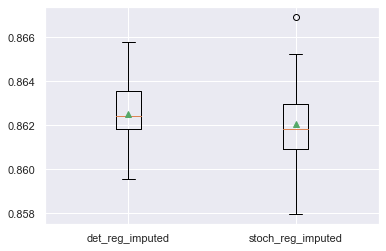

In [47]:
results = []
regressions = [det_reg_imputed_df1,stoch_reg_imputed_df1,]
names = ['det_reg_imputed','stoch_reg_imputed']
# X, y = df1[missing_columns_to_impute], df1['B_PLUS_FLAG'] # NOTE: B_PLUS_FLAG is the target variable


for index, regression in enumerate(regressions):
  print(index)
  # # Essentially we are filling every column with it's grouped ID's average value per column. 
  data = regression

  missing_columns_to_impute = data_imputed_dataframe_func(df1)[1] 
  missing_columns = []
  if index == 0:
    for item in missing_columns_to_impute: missing_columns.append("Det."+item)
  else:
    for item in missing_columns_to_impute: missing_columns.append("Stoch."+item)

  X, y = data[missing_columns], df1['B_PLUS_FLAG']
  pipeline = Pipeline(steps=[('m', RandomForestClassifier())])
  cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
  scores = cross_val_score(pipeline, X, y, scoring='accuracy', cv=cv, n_jobs=-1)
  # store results
  results.append(scores)

plt.boxplot(results, labels=names, showmeans=True)
plt.show()

In [48]:
regressed_data = [det_reg_imputed_df1,det_reg_imputed_df2,stoch_reg_imputed_df1,stoch_reg_imputed_df2]
regressed_data_name = ["Deterministic Regression of df1", "Deterministic Regression of df2", "Stochastic Regression of df1", "Stochastic Regression of df2"]
for i in range(4):
  print(f'{avg_num_missing_values(regressed_data[i])} avg. number of missing values in {regressed_data_name[i]}')

0.0 avg. number of missing values in Deterministic Regression of df1
0.0 avg. number of missing values in Deterministic Regression of df2
0.0 avg. number of missing values in Stochastic Regression of df1
0.0 avg. number of missing values in Stochastic Regression of df2


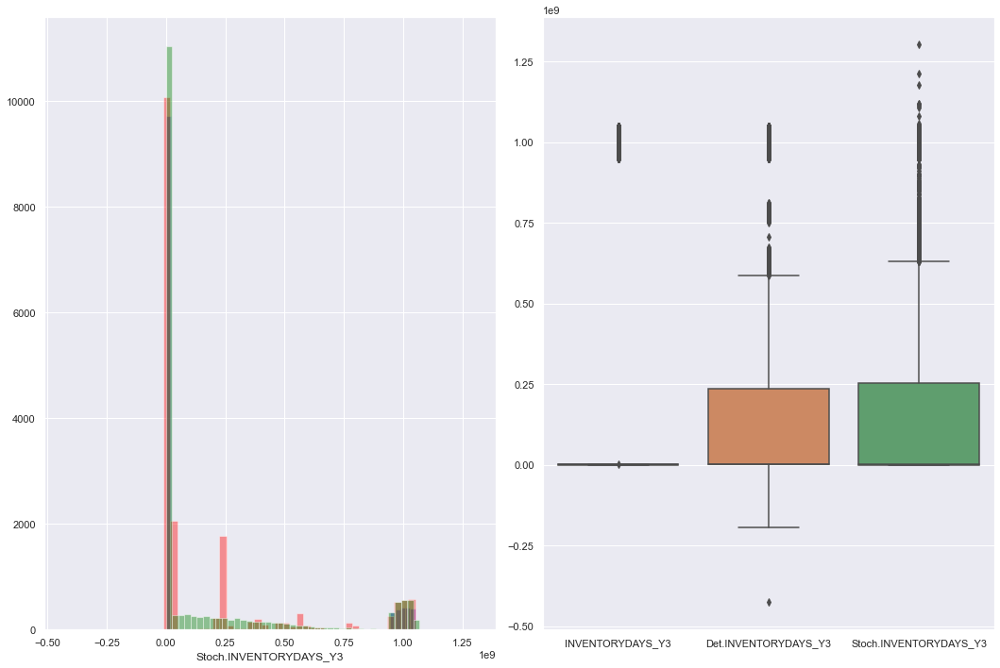

In [49]:
sns.set()
fig, axes = plt.subplots(nrows = 1, ncols = 2)
fig.set_size_inches(15, 10)

variable = 'INVENTORYDAYS_Y3' #Initial assessment showed inventory days had the highest number of missing values
sns.distplot(df1[variable].dropna(), kde = False, ax = axes[0], color = 'blue')
sns.distplot(det_reg_imputed_df1["Det." + variable], kde = False, ax = axes[0], color = 'red')
sns.distplot(stoch_reg_imputed_df1["Stoch." + variable], kde = False, ax = axes[0], color = 'green')

sns.boxplot(data = pd.concat([df1[variable], det_reg_imputed_df1["Det." + variable], stoch_reg_imputed_df1['Stoch.' + variable]],axis = 1), ax = axes[1])

plt.tight_layout()

In [50]:
# Create a list of all imputed methods here -- (Need to create do some growth / financial average imputation)
# We will just use df1 for now to test the accuracy of different imputation methods
# Run the LR and DC models to see how well the datasets perform.  

In [52]:
"""
from google.colab import files

det_reg_imputed_df1.to_csv("det_reg_imputed_df1.csv", index=False)
files.download('det_reg_imputed_df1.csv')
det_reg_imputed_df2.to_csv("det_reg_imputed_df2.csv", index=False)
files.download('det_reg_imputed_df2.csv')
stoch_reg_imputed_df1.to_csv("stoch_reg_imputed_df1.csv", index=False)
files.download('stoch_reg_imputed_df1.csv')
stoch_reg_imputed_df2.to_csv("stoch_reg_imputed_df2.csv", index=False)
files.download('stoch_reg_imputed_df2.csv')
"""
print(" ")

In [53]:
#### What if we fill it by grouped ID means / column?
df1.groupby("CUSTOMER_ID").mean()

,ROW,Corp_Residence_Country_Code,BR Code,Final_IG,B_PLUS_FLAG,EBITDA_Y0,EBITDA_Y1,EBITDA_Y2,EBITDA_Y3,TOTALASSET_Y0,TOTALASSET_Y1,TOTALASSET_Y2,TOTALASSET_Y3,TOTALDEBT_Y0,TOTALDEBT_Y1,TOTALDEBT_Y2,TOTALDEBT_Y3,TOTALREVENUE_Y0,TOTALREVENUE_Y1,TOTALREVENUE_Y2,TOTALREVENUE_Y3,CURRENTASSET_Y0,CURRENTASSET_Y1,CURRENTASSET_Y2,CURRENTASSET_Y3,FIXEDASSET_Y0,FIXEDASSET_Y1,FIXEDASSET_Y2,FIXEDASSET_Y3,CURRENTLIABILITY_Y0,CURRENTLIABILITY_Y1,CURRENTLIABILITY_Y2,CURRENTLIABILITY_Y3,NONCURRLIA_Y0,NONCURRLIA_Y1,NONCURRLIA_Y2,NONCURRLIA_Y3,TOTALEQUITY_Y0,TOTALEQUITY_Y1,TOTALEQUITY_Y2,TOTALEQUITY_Y3,TOTALNETWORTH_Y0,TOTALNETWORTH_Y1,TOTALNETWORTH_Y2,TOTALNETWORTH_Y3,CAPITALIZATION_Y0,CAPITALIZATION_Y1,CAPITALIZATION_Y2,CAPITALIZATION_Y3,TOTINTEXP_Y0,TOTINTEXP_Y1,TOTINTEXP_Y2,TOTINTEXP_Y3,LEASERENTEXP_Y0,LEASERENTEXP_Y1,LEASERENTEXP_Y2,LEASERENTEXP_Y3,EBITDAR_Y0,EBITDAR_Y1,EBITDAR_Y2,EBITDAR_Y3,receivabledays_Y0,receivabledays_Y1,receivabledays_Y2,receivabledays_Y3,INVENTORYDAYS_Y0,INVENTORYDAYS_Y1,INVENTORYDAYS_Y2,INVENTORYDAYS_Y3,payableDAYS_Y0,payableDAYS_Y1,payableDAYS_Y2,payableDAYS_Y3,Capex2Dep_Y0,Capex2Dep_Y1,Capex2Dep_Y2,tangibleNetWorth_Y0,tangibleNetWorth_Y1,tangibleNetWorth_Y2,tangibleNetWorth_Y3,FIXEDCHARGECOV_Y0,FIXEDCHARGECOV_Y1,FIXEDCHARGECOV_Y2,FIXEDCHARGECOV_Y3,DEBTSERVCOV_Y0,DEBTSERVCOV_Y1,DEBTSERVCOV_Y2,DEBTSERVCOV_Y3,NETPROFIT_Y0,NETPROFIT_Y1,NETPROFIT_Y2,NETPROFIT_Y3,NETSALES_Y0,NETSALES_Y1,NETSALES_Y2,NETSALES_Y3,ASSETTURNOVER_Y0,ASSETTURNOVER_Y1,ASSETTURNOVER_Y2,ASSETTURNOVER_Y3,OPERPROFIT_Y0,OPERPROFIT_Y1,OPERPROFIT_Y2,OPERPROFIT_Y3,ARTurnover_Y0,ARTurnover_Y1,ARTurnover_Y2,ARTurnover_Y3,Inventory_Y0,Inventory_Y1,Inventory_Y2,Inventory_Y3,RETAINED_EARNINGS_Y0,RETAINED_EARNINGS_Y1,RETAINED_EARNINGS_Y2,RETAINED_EARNINGS_Y3,FCF_Y0,FCF_Y1,FCF_Y2,CCE_Y0,CCE_Y1,CCE_Y2,CCE_Y3,Year,Month
CUSTOMER_ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,2.500000,0.0,0.0,7.000000,1.0,594646.413610,596818.066123,599387.899213,608043.506296,609413.265796,592671.737093,599630.389447,598484.795140,593980.985697,614720.072314,619058.416093,611257.492821,612743.072034,610631.890515,618888.116289,575765.908584,605785.073746,611725.292974,605771.599609,578189.877171,600396.178331,600765.605090,616573.773711,588695.367929,610151.107253,619901.282827,588950.812183,599501.380908,595821.516725,598134.061131,594573.687865,602846.687782,594234.762791,596884.992842,601364.247894,582762.916470,588201.338922,610807.794893,621596.129580,580324.093351,582629.520190,581584.195300,602736.918591,588519.232916,614791.416774,597430.060887,584925.771664,589295.675911,624068.444037,603855.230490,593784.434458,587317.360293,610048.699252,606933.714229,608988.281029,605032.233769,608942.037556,616409.879660,624501.054444,627075.643657,6.165998e+05,5.776075e+05,5.875797e+05,5.887317e+05,6.122466e+05,6.081201e+05,5.967827e+05,6.031793e+05,598148.445114,612154.787603,587727.493219,624479.393144,605133.939453,577821.763017,577741.078949,5.948888e+05,5.918090e+05,6.108683e+05,6.022386e+05,5.891041e+05,5.960117e+05,6.113894e+05,6.270547e+05,575882.195553,583930.748426,606799.468309,627140.627628,603209.264256,581667.164895,600615.501236,593966.052639,616636.128616,604756.239593,593139.842451,613220.698155,599776.224824,581432.829430,577160.310385,595747.313056,596146.499590,609502.488967,611374.564202,624184.466138,599846.346435,584857.232442,598295.771349,591900.671899,610095.092780,590288.015636,603684.048093,574251.412954,579560.663096,601189.566838,619823.971210,589609.826937,607835.253391,590764.454149,574860.551018,2016.500000,2.500000
3,11.000000,0.0,2.0,5.333333,1.0,586334.569910,601871.976674,601799.785980,624576.922508,605399.262320,604640.944685,593801.616282,586259.475857,589285.582580,586101.286676,612301.163106,579458.516553,602983.403722,601821.105723,615926.840113,615719.960213,606534.222158,603327.675796,612576.917384,626388.837969,594703.863759,596210.685230,594776.180485,61

In [54]:
data = df1.copy()

In [55]:
#data['TOTALASSET_Y0']=data.groupby('CUSTOMER_ID')['TOTALASSET_Y0'].apply(lambda x:x.fillna(x.mean()))

In [59]:
# # Essentially we are filling every column with it's grouped ID's average value per column. 
def impute_average_and_constant(data,group = 'CUSTOMER_ID',constant = 0):
  """This will impute the missing values by grouping the dataset based on a shared value in a column. 
  If no groups can be made (i.e. only one dataset in a group, then the missing data will be imputed with a constant.
  
  data - the data table to be imputed on. Type = pandas dataframe
  group - the column to group by. Default is CUSTOMER_ID
  constant - the constant to impute any data that cannot be grouped. Default is 0
  
  """
  for col in data.columns:
    data[col] = data.groupby('CUSTOMER_ID')[col].apply(lambda x:x.fillna(x.mean()))

  data = data.fillna(constant)
  return data

# This is now clean, imputed data.
df1 = impute_average_and_constant(df1)
df2 = impute_average_and_constant(df2)

In [60]:
df1.isnull().sum()

ROW                            0
Corp_Residence_Country_Code    0
BR Code                        0
CUSTOMER_ID                    0
Final_IG                       0
B_PLUS_FLAG                    0
EBITDA_Y0                      0
EBITDA_Y1                      0
EBITDA_Y2                      0
EBITDA_Y3                      0
TOTALASSET_Y0                  0
TOTALASSET_Y1                  0
TOTALASSET_Y2                  0
TOTALASSET_Y3                  0
TOTALDEBT_Y0                   0
TOTALDEBT_Y1                   0
TOTALDEBT_Y2                   0
TOTALDEBT_Y3                   0
TOTALREVENUE_Y0                0
TOTALREVENUE_Y1                0
TOTALREVENUE_Y2                0
TOTALREVENUE_Y3                0
CURRENTASSET_Y0                0
CURRENTASSET_Y1                0
CURRENTASSET_Y2                0
CURRENTASSET_Y3                0
FIXEDASSET_Y0                  0
FIXEDASSET_Y1                  0
FIXEDASSET_Y2                  0
FIXEDASSET_Y3                  0
CURRENTLIA

### Outlier Detection

In [62]:
# Even after imputation / dropping values, we still have to deal with outliers (Which are VERY far from the mean)
df1.describe()

,ROW,Corp_Residence_Country_Code,BR Code,CUSTOMER_ID,Final_IG,B_PLUS_FLAG,EBITDA_Y0,EBITDA_Y1,EBITDA_Y2,EBITDA_Y3,TOTALASSET_Y0,TOTALASSET_Y1,TOTALASSET_Y2,TOTALASSET_Y3,TOTALDEBT_Y0,TOTALDEBT_Y1,TOTALDEBT_Y2,TOTALDEBT_Y3,TOTALREVENUE_Y0,TOTALREVENUE_Y1,TOTALREVENUE_Y2,TOTALREVENUE_Y3,CURRENTASSET_Y0,CURRENTASSET_Y1,CURRENTASSET_Y2,CURRENTASSET_Y3,FIXEDASSET_Y0,FIXEDASSET_Y1,FIXEDASSET_Y2,FIXEDASSET_Y3,CURRENTLIABILITY_Y0,CURRENTLIABILITY_Y1,CURRENTLIABILITY_Y2,CURRENTLIABILITY_Y3,NONCURRLIA_Y0,NONCURRLIA_Y1,NONCURRLIA_Y2,NONCURRLIA_Y3,TOTALEQUITY_Y0,TOTALEQUITY_Y1,TOTALEQUITY_Y2,TOTALEQUITY_Y3,TOTALNETWORTH_Y0,TOTALNETWORTH_Y1,TOTALNETWORTH_Y2,TOTALNETWORTH_Y3,CAPITALIZATION_Y0,CAPITALIZATION_Y1,CAPITALIZATION_Y2,CAPITALIZATION_Y3,TOTINTEXP_Y0,TOTINTEXP_Y1,TOTINTEXP_Y2,TOTINTEXP_Y3,LEASERENTEXP_Y0,LEASERENTEXP_Y1,LEASERENTEXP_Y2,LEASERENTEXP_Y3,EBITDAR_Y0,EBITDAR_Y1,EBITDAR_Y2,EBITDAR_Y3,receivabledays_Y0,receivabledays_Y1,receivabledays_Y2,receivabledays_Y3,INVENTORYDAYS_Y0,INVENTORYDAYS_Y1,INVENTORYDAYS_Y2,INVENTORYDAYS_Y3,payableDAYS_Y0,payableDAYS_Y1,payableDAYS_Y2,payableDAYS_Y3,Capex2Dep_Y0,Capex2Dep_Y1,Capex2Dep_Y2,tangibleNetWorth_Y0,tangibleNetWorth_Y1,tangibleNetWorth_Y2,tangibleNetWorth_Y3,FIXEDCHARGECOV_Y0,FIXEDCHARGECOV_Y1,FIXEDCHARGECOV_Y2,FIXEDCHARGECOV_Y3,DEBTSERVCOV_Y0,DEBTSERVCOV_Y1,DEBTSERVCOV_Y2,DEBTSERVCOV_Y3,NETPROFIT_Y0,NETPROFIT_Y1,NETPROFIT_Y2,NETPROFIT_Y3,NETSALES_Y0,NETSALES_Y1,NETSALES_Y2,NETSALES_Y3,ASSETTURNOVER_Y0,ASSETTURNOVER_Y1,ASSETTURNOVER_Y2,ASSETTURNOVER_Y3,OPERPROFIT_Y0,OPERPROFIT_Y1,OPERPROFIT_Y2,OPERPROFIT_Y3,ARTurnover_Y0,ARTurnover_Y1,ARTurnover_Y2,ARTurnover_Y3,Inventory_Y0,Inventory_Y1,Inventory_Y2,Inventory_Y3,RETAINED_EARNINGS_Y0,RETAINED_EARNINGS_Y1,RETAINED_EARNINGS_Y2,RETAINED_EARNINGS_Y3,FCF_Y0,FCF_Y1,FCF_Y2,CCE_Y0,CCE_Y1,CCE_Y2,CCE_Y3,Year,Month
count,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000,17662.000000
mean,19916.844921,0.299513,15.410316,6155.584702,6.726135,0.859076,600405.395597,600320.671236,599839.992876,595308.051045,607961.501398,607547.578481,606973.083042,601352.021447,601709.782926,601581.437533,601234.032582,596181.033903,609478.689842,609126.145938,608366.822605,602645.876177,603256.381762,603062.368437,602677.478042,597465.640310,608413.277886,607706.341765,607238.617053,601261.216026,602123.709085,601766.424526,601405.038431,596814.891316,600924.680925,600802.087402,600820.935104,595650.802333,602652.19013

In [61]:
data1 = df1.copy()
non_financial_features = ['ROW','Corp_Residence_Country_Code', 'BR Code', 'CUSTOMER_ID', 'Final_IG', 'B_PLUS_FLAG', 'Year', 'Month', 'Date']
financial_features = data1.drop(non_financial_features, axis=1)
fin_features_lst = list(financial_features.columns)

def outlier_replace(data, col_name, q1=0.25, q3=0.75):
    quartile1 = data[col_name].quantile(q1)
    quartile3 = data[col_name].quantile(q3)
    interquantile_range = quartile3 - quartile1
    up_limit = quartile3 + 1.5 * interquantile_range
    low_limit = quartile1 - 1.5 * interquantile_range
    data.loc[(data[col_name] < low_limit), col_name] = low_limit
    data.loc[(data[col_name] > up_limit), col_name] = up_limit
    

# Fix outliers in Financial Features for DF1
for col in df1.columns:
    if col in fin_features_lst:
        outlier_replace(df1,col)
    else:
        pass

# Do the same for DF2
for col in df2.columns:
    if col in fin_features_lst:
        outlier_replace(df2,col)
    else:
        pass

##  Further Analysis (Barplots, Scatterplots, CustomerID, Classes, Clustering)<a class="anchor" id="2.2"></a>

In [63]:
print("Canadian Companies:")
counts_0_df1, counts_1_df1 = df1["B_PLUS_FLAG"].value_counts()[0], df1["B_PLUS_FLAG"].value_counts()[1]
print("Percentage of canadian companies where Flag == 1:", (counts_1_df1/(counts_0_df1 + counts_1_df1))*100, "%")
print("Percentage of canadian companies where Flag == 0:", (counts_0_df1/(counts_0_df1 + counts_1_df1))*100, "%")
print("General Companies:")
counts_0_df2, counts_1_df2 = df2["B_PLUS_FLAG"].value_counts()[0], df2["B_PLUS_FLAG"].value_counts()[1]
print("Percentage of canadian companies where Flag == 1:", (counts_1_df2/(counts_0_df2 + counts_1_df2))*100, "%")
print("Percentage of canadian companies where Flag == 0:", (counts_0_df2/(counts_0_df2 + counts_1_df2))*100, "%")

Canadian Companies:
Percentage of canadian companies where Flag == 1: 85.90759823349565 %
Percentage of canadian companies where Flag == 0: 14.09240176650436 %
General Companies:
Percentage of canadian companies where Flag == 1: 77.39104858081278 %
Percentage of canadian companies where Flag == 0: 22.608951419187214 %


Here we can see that the class imbalance problem persists in both datasets. <br>
Roughly, about 80% of the data is in class 1 vs 20% in class 2 for both datasets. <br>


### Correlation between variables

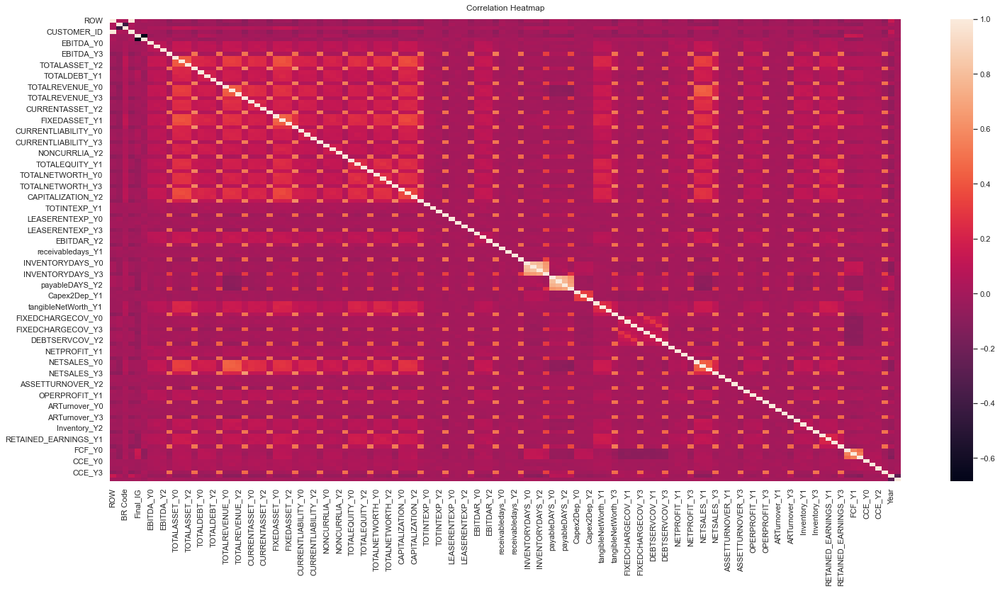

In [64]:
plt.figure(figsize=(25, 12))
heatmap = sns.heatmap(df1.corr(), annot=False);
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':12}, pad=12);

**K-Means Clustering**

In [65]:
# K-Means clustering
from numpy import unique
from numpy import where
import copy
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

from sklearn.cluster import KMeans

X_KMeans = copy.deepcopy(df1)
drop_features = ["Period", 'Date','Year','Month','ROW']
for drop_feature in drop_features:
  try: X_KMeans = X_KMeans.drop(drop_feature, axis = 1) #String values must be dropped for K-Means.
  except: continue
X_KMeans.fillna(X_KMeans.mean(), inplace=True)


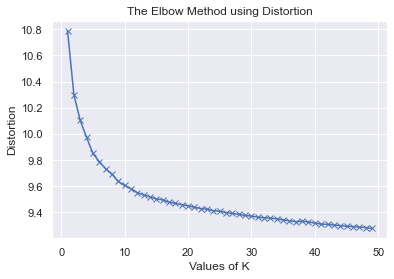

In [66]:
#Elbow Method to determine optimal number of clusters needed for K-Means
from scipy.spatial.distance import cdist
distortions = []
inertias = []
mapping1 = {}
mapping2 = {}
K = range(1, 50)

from sklearn.preprocessing import StandardScaler
# Standardize the data
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_KMeans)

X = X_scaled
for k in K:
    # Building and fitting the model
    kmeanModel = KMeans(n_clusters=k, n_init=10).fit(X)
    kmeanModel.fit(X)
 
    distortions.append(sum(np.min(cdist(X, kmeanModel.cluster_centers_,
                                        'euclidean'), axis=1)) / X.shape[0])
    inertias.append(kmeanModel.inertia_)
 
    mapping1[k] = sum(np.min(cdist(X, kmeanModel.cluster_centers_,
                                   'euclidean'), axis=1)) / X.shape[0]
    mapping2[k] = kmeanModel.inertia_

plt.plot(K, distortions, 'bx-')
plt.xlabel('Values of K')
plt.ylabel('Distortion')
plt.title('The Elbow Method using Distortion')
plt.show()

Based on the above graph, the "Elbow" appears around N=6 to 12. Using 6 to identify a broader range of clusters.

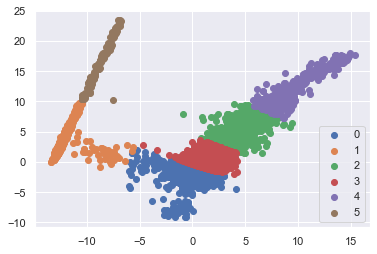

[9, 13, 16, 23, 28, 31, 37, 44, 46, 47, 48, 50, 54, 58, 67, 81, 93, 99, 101, 105, 106, 107, 112, 113, 115, 119, 131, 132, 134, 135, 136, 144, 147, 150, 153, 157, 169, 171, 175, 176, 180, 181, 183, 184, 191, 192, 205, 207, 208, 211, 214, 215, 217, 222, 231, 238, 240, 243, 246, 248, 249, 252, 254, 265, 267, 280, 282, 283, 285, 286, 287, 293, 295, 296, 303, 304, 310, 316, 319, 322, 325, 328, 333, 337, 338, 339, 341, 349, 351, 355, 358, 364, 367, 368, 369, 370, 373, 374, 375, 377, 387, 388, 391, 393, 400, 401, 411, 412, 414, 417, 418, 420, 427, 429, 433, 434, 445, 449, 451, 453, 454, 457, 459, 477, 481, 482, 487, 488, 489, 491, 494, 496, 497, 498, 499, 511, 513, 519, 521, 523, 525, 527, 528, 531, 533, 539, 546, 547, 550, 554, 556, 557, 558, 561, 565, 569, 572, 573, 575, 578, 580, 583, 585, 588, 589, 590, 594, 595, 600, 601, 602, 608, 610, 611, 613, 617, 624, 635, 639, 640, 647, 648, 649, 651, 652, 653, 655, 657, 661, 665, 671, 683, 690, 695, 702, 704, 707, 710, 713, 717, 722, 725, 731, 732

In [67]:
# Standardize the data
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_KMeans)

#Reduce dimensionality to visualize it on a 2D plane
pca = PCA(2) 
cluster_df = pca.fit_transform(X_scaled)

clusters = [6]

for n_clusters in clusters:
  model = KMeans(n_clusters=n_clusters, random_state=0)

  #predict the labels of clusters.
  label = model.fit_predict(cluster_df)
  # retrieve unique clusters
  u_labels = unique(label)


  for i in u_labels:
    plt.scatter(cluster_df[label == i , 0] , cluster_df[label == i , 1] , label = i)
  plt.legend()
  plt.show()

# Add the cluster number to the original scaled data
X_clustered = pd.DataFrame(X_scaled, index=X_KMeans.index, columns=X_KMeans.columns)
X_clustered["cluster"] = label

# # Display parallel coordinates plots, 
# pd.plotting.parallel_coordinates(X_clustered, "cluster")

cluster_counts = X_clustered["cluster"].value_counts()
outlier_indices = list(X_clustered[X_clustered["cluster"] != 0].index)
print(outlier_indices)

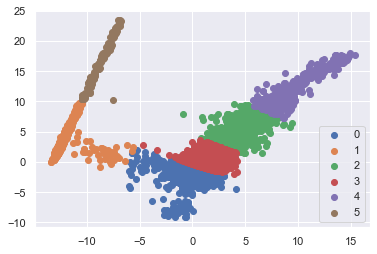

A total of 0 outliers were removed.


<AxesSubplot:>

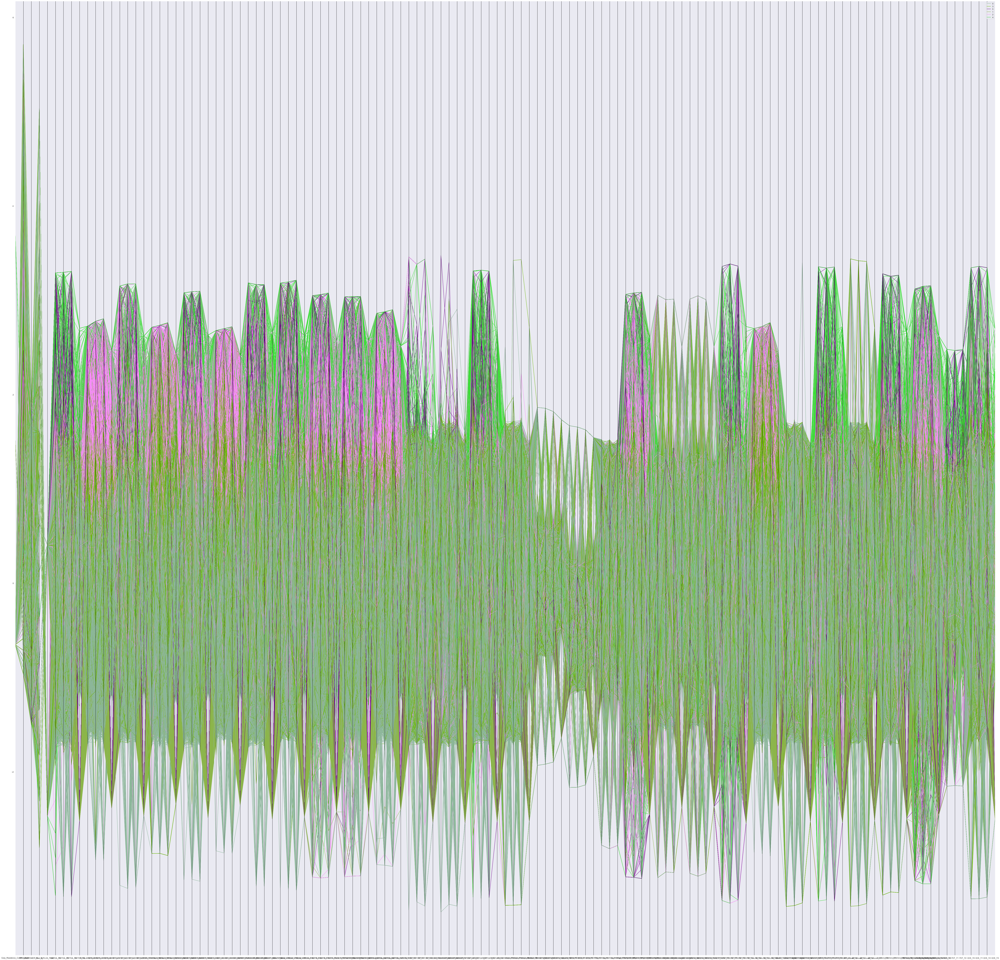

In [68]:
##Testing to remove outliers until KMeans is producing groups without having a signifcant proportion of the data in one group

def check_percentage_outlier(counts_arr):
  counts_arr = counts_arr.sort_index()
  number_of_clusters = len(counts_arr)
  total = counts_arr.sum()
  remove_clusters = []
  threshold = 0.05
  for index, count in enumerate(counts_arr):
    percentage = count / total
    if percentage < threshold: remove_clusters.append(index)
    else: continue
  if len(remove_clusters) <= math.floor(number_of_clusters * 1/3): return (False, remove_clusters) #Two was chosen arbritrarily. This means that it will permit two clusters to contain values below the threshold
  return (True, remove_clusters)

Iterations = 1
##initial K_Means Clustering
# Standardize the data
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_KMeans)

#Reduce dimensionality to visualize it on a 2D plane
pca = PCA(2) 
cluster_df = pca.fit_transform(X_scaled)
KMeans_outliers = []
clusters_to_use = 6

model = KMeans(n_clusters=clusters_to_use, random_state=0)

#predict the labels of clusters.
label = model.fit_predict(cluster_df)

# Add the cluster number to the original scaled data
X_clustered = pd.DataFrame(X_scaled, index=X_KMeans.index, columns=X_KMeans.columns)
X_clustered["cluster"] = label

cluster_counts = X_clustered["cluster"].value_counts()
outlier_indices = list(X_clustered[X_clustered["cluster"] != 0].index)

#predict the labels of clusters.
label = model.fit_predict(cluster_df)
# retrieve unique clusters
u_labels = unique(label)

for i in u_labels:
  plt.scatter(cluster_df[label == i , 0] , cluster_df[label == i , 1] , label = i)
plt.legend()
plt.show()

X_KMeans_outliers_removed = copy.copy(X_KMeans.copy())
X_scaled_outliers_removed = scaler.fit_transform(X_KMeans_outliers_removed)

outliers_present = check_percentage_outlier(cluster_counts)

if outliers_present[0]: print("Outliers found, will reiterate to improve clustering results.")
while (outliers_present[0]):
  print(f'Number of KMean iterations done: {Iterations}')
  Iterations += 1

  # Standardize the data
  scaler = StandardScaler()
  X_scaled_outliers_removed = scaler.fit_transform(X_KMeans_outliers_removed)

  #Reduce dimensionality to visualize it on a 2D plane
  pca = PCA(2) 
  cluster_df_outliers_removed = pca.fit_transform(X_scaled_outliers_removed)

  model = KMeans(n_clusters=clusters_to_use, random_state=0)

  #predict the labels of clusters.
  label = model.fit_predict(cluster_df_outliers_removed)
  # retrieve unique clusters
  u_labels = unique(label)
  
  # Add the cluster number to the original scaled data
  X_clustered_outliers_removed = pd.DataFrame(X_scaled_outliers_removed, index=X_KMeans_outliers_removed.index, columns=X_KMeans.columns)
  X_clustered_outliers_removed["cluster"] = label

  cluster_counts = X_clustered["cluster"].value_counts()
  outlier_indices = list(X_clustered[X_clustered["cluster"] != 0].index)

  cluster_counts = X_clustered_outliers_removed["cluster"].value_counts()
  outliers_present = check_percentage_outlier(cluster_counts)

  print(cluster_counts)

  print(f"Outlier Clusters are {outliers_present[1]}")
  if outliers_present[0]:
    print(outliers_present[1])
    outlier_indices = list(X_clustered_outliers_removed[X_clustered_outliers_removed["cluster"].isin(outliers_present[1])].index)
    print(f"removed {len(outlier_indices)} values:")

    #Append the outlier indexes to a list for reference purposes
    for outlier_index in outlier_indices:
      KMeans_outliers.append(outlier_index)
    X_KMeans_outliers_removed.drop(outlier_indices, inplace = True)
  
  for i in u_labels:
    plt.scatter(cluster_df_outliers_removed[label == i , 0] , cluster_df_outliers_removed[label == i , 1] , label = i)
  plt.legend()
  plt.show()

#Print total number of outliers removed
print(f'A total of {len(KMeans_outliers)} outliers were removed.')

# Add the cluster number to the original scaled data
X_clustered_outliers_removed = pd.DataFrame(X_scaled_outliers_removed, index=X_KMeans_outliers_removed.index, columns=X_KMeans_outliers_removed.columns)
X_clustered_outliers_removed["cluster"] = label

parallel_plot_indices = list(X_clustered_outliers_removed.index)

# Display parallel coordinates plots
plt.figure(figsize=(100,100))
pd.plotting.parallel_coordinates(X_clustered_outliers_removed, "cluster")

In [69]:
print(KMeans_outliers)

[]


In [70]:
list(X_clustered_outliers_removed.columns)[67:71]

['INVENTORYDAYS_Y2', 'INVENTORYDAYS_Y3', 'payableDAYS_Y0', 'payableDAYS_Y1']

In [71]:
# Create correlation matrix
corr_matrix = df1.corr().abs()
corr_matrix

,ROW,Corp_Residence_Country_Code,BR Code,CUSTOMER_ID,Final_IG,B_PLUS_FLAG,EBITDA_Y0,EBITDA_Y1,EBITDA_Y2,EBITDA_Y3,TOTALASSET_Y0,TOTALASSET_Y1,TOTALASSET_Y2,TOTALASSET_Y3,TOTALDEBT_Y0,TOTALDEBT_Y1,TOTALDEBT_Y2,TOTALDEBT_Y3,TOTALREVENUE_Y0,TOTALREVENUE_Y1,TOTALREVENUE_Y2,TOTALREVENUE_Y3,CURRENTASSET_Y0,CURRENTASSET_Y1,CURRENTASSET_Y2,CURRENTASSET_Y3,FIXEDASSET_Y0,FIXEDASSET_Y1,FIXEDASSET_Y2,FIXEDASSET_Y3,CURRENTLIABILITY_Y0,CURRENTLIABILITY_Y1,CURRENTLIABILITY_Y2,CURRENTLIABILITY_Y3,NONCURRLIA_Y0,NONCURRLIA_Y1,NONCURRLIA_Y2,NONCURRLIA_Y3,TOTALEQUITY_Y0,TOTALEQUITY_Y1,TOTALEQUITY_Y2,TOTALEQUITY_Y3,TOTALNETWORTH_Y0,TOTALNETWORTH_Y1,TOTALNETWORTH_Y2,TOTALNETWORTH_Y3,CAPITALIZATION_Y0,CAPITALIZATION_Y1,CAPITALIZATION_Y2,CAPITALIZATION_Y3,TOTINTEXP_Y0,TOTINTEXP_Y1,TOTINTEXP_Y2,TOTINTEXP_Y3,LEASERENTEXP_Y0,LEASERENTEXP_Y1,LEASERENTEXP_Y2,LEASERENTEXP_Y3,EBITDAR_Y0,EBITDAR_Y1,EBITDAR_Y2,EBITDAR_Y3,receivabledays_Y0,receivabledays_Y1,receivabledays_Y2,receivabledays_Y3,INVENTORYDAYS_Y0,INVENTORYDAYS_Y1,INVENTORYDAYS_Y2,INVENTORYDAYS_Y3,payableDAYS_Y0,payableDAYS_Y1,payableDAYS_Y2,payableDAYS_Y3,Capex2Dep_Y0,Capex2Dep_Y1,Capex2Dep_Y2,tangibleNetWorth_Y0,tangibleNetWorth_Y1,tangibleNetWorth_Y2,tangibleNetWorth_Y3,FIXEDCHARGECOV_Y0,FIXEDCHARGECOV_Y1,FIXEDCHARGECOV_Y2,FIXEDCHARGECOV_Y3,DEBTSERVCOV_Y0,DEBTSERVCOV_Y1,DEBTSERVCOV_Y2,DEBTSERVCOV_Y3,NETPROFIT_Y0,NETPROFIT_Y1,NETPROFIT_Y2,NETPROFIT_Y3,NETSALES_Y0,NETSALES_Y1,NETSALES_Y2,NETSALES_Y3,ASSETTURNOVER_Y0,ASSETTURNOVER_Y1,ASSETTURNOVER_Y2,ASSETTURNOVER_Y3,OPERPROFIT_Y0,OPERPROFIT_Y1,OPERPROFIT_Y2,OPERPROFIT_Y3,ARTurnover_Y0,ARTurnover_Y1,ARTurnover_Y2,ARTurnover_Y3,Inventory_Y0,Inventory_Y1,Inventory_Y2,Inventory_Y3,RETAINED_EARNINGS_Y0,RETAINED_EARNINGS_Y1,RETAINED_EARNINGS_Y2,RETAINED_EARNINGS_Y3,FCF_Y0,FCF_Y1,FCF_Y2,CCE_Y0,CCE_Y1,CCE_Y2,CCE_Y3,Year,Month
ROW,1.000000,0.040534,0.028263,0.988315,0.000846,0.032480,0.002104,0.012918,0.019920,0.084377,0.020248,0.016211,0.027963,0.078969,0.002406,0.007401,0.017766,0.074157,0.015632,0.007316,0.021151,0.093083,0.010061,0.027732,0.032231,0.088482,0.017237,0.015406,0.010289,0.079549,0.018844,0.009140,0.000411,0.071729,0.003117,0.006138,0.015362,0.084237,0.014042,0.010389,0.020466,0.077737,0.018921,0.019472,0.013912,0.083491,0.009226,0.008751,0.020429,0.075472,0.009637,0.009200,0.004884,0.073058,0.007923,0.000181,0.002305,0.067340,0.012766,0.024880,0.012648,0.083255,0.008482,0.017852,0.020357,0.070904,0.007772,0.012510,0.008024,0.052995,0.021817,0.022562,0.023824,0.030228,0.015122,0.010594,0.020515,0.020362,0.025270,0.023337,0.089690,0.000611,0.009738,0.003357,0.059059,0.007108,0.012953,0.005146,0.063402,0.007730,0.001725,0.007199,0.079128,0.009715,0.015054,0.026756,0.082171,0.002711,0.011613,0.010450,0.069715,0.006957,0.010288,0.010864,0.067184,0.015603,0.003930,0.003573,0.068883,0.002667,0.014005,0.008322,0.085993,0.006087,0.021304,0.024999,0.088925,0.002570,0.027029,0.029740,0.005260,0.004362,0.013878,0.086764,0.141687,0.013038
Corp_Residence_Country_Code,0.040534,1.000000,0.421162,0.039464,0.012517,0.014716,0.012318,0.014064,0.013408,0.059784,0.065499,0.062712,0.057908,0.078732,0.045208,0.031592,0.025771,0.068276,0.086401,0.073974,0.068564,0.087669,0.041112,0.036172,0.034240,0.077269,0.056862,0.056166,0.061956,0.084346,0.022746,0.033103,0.023165,0.067228,0.023015,0.013125,0.019991,0.062645,0.039069,0.036310,0.033364,0.063754,0.040084,0.043310,0.044826,0.064000,0.044338,0.044211,0.054357,0.078256,0.008772,0.004911,0.003403,0.057987,0.015019,0.000665,0.005424,0.047543,0.022846,0.030230,0.018897,0.057302,0.015573,0.002475,0.000963,0.046766,0.047689,0.050593,0.043458,0.074543,0.005277,0.002366,0.004571,0.037606,0.003393,0.014265,0.010721,0.016486,0.025439,0.015233,0.072370,0.030976,0.023548,0.025681,0.035927,0.015184,0.031038,0.018262,0.027750,0.017952,0.001627,0.012833,0.057475,0.063693,0.070907,0.065301,0.093503,0.004960,0.006016,0.003046,0.051966,0.017937,0.014838,0.001783,0.047851,0.008114,0.009594,0.014356,0.046705,0.021716,0.020584,0.0087

### Using Automatic EDA 

-- If this doesn't work, we can just remove it from the notebook and upload it seperately. 

In [72]:
#df1_EDA = ProfileReport(df1, title="Canadian Companies Report", minimal=True)
#df1_EDA

In [73]:
# df2_EDA = ProfileReport(df2, title="General Companies Report", minimal=True)
# df2_EDA

In [74]:
# Save the files in HTML format 
#df1_EDA.to_file("Canadian_Companies_Analysis.html")
#df2_EDA.to_file("General_Companies_Analysis.html")

#### Automatic EDA Notes
Based on the EDA for both datasets, they seem very similar (in terms of distributions of the columns). <br> 
We notice alot of columns are very skewed, and the distribution for almost all columns does not seem normal. <br>
We also see a bunch of outliers (i.e values which are way beyond the 99% of the data distribution). 
We will need to dig a bit deeper to see more. 

In [75]:
data_1 = df1.iloc[: , :20]
data_2 = df1.iloc[: , 40:80]
data_3 = df1.iloc[: , 80:]

In [76]:
# Lets plot out some pairs to see whats going on in terms of co-relation
# Drop some columns for SNS plot
data_1 = data_1.drop(['ROW', 'Corp_Residence_Country_Code', 'CUSTOMER_ID', "TOTALREVENUE_Y0", "EBITDA_Y0", "TOTALASSET_Y0", "TOTALDEBT_Y3", "TOTALREVENUE_Y1", "TOTALASSET_Y3", "TOTALASSET_Y2", "BR Code" ], axis=1)

In [77]:
data_1.head()

,Final_IG,B_PLUS_FLAG,EBITDA_Y1,EBITDA_Y2,EBITDA_Y3,TOTALASSET_Y1,TOTALDEBT_Y0,TOTALDEBT_Y1,TOTALDEBT_Y2
0,5,1,602838.635998,583646.469630,614602.866245,621095.725446,623105.791017,596800.177680,600460.033208
3,5,1,581915.869330,594033.887481,609965.034011,598332.776102,584513.060799,626767.691011,625743.779183
5,6,1,621363.457818,620204.377021,626451.386863,609550.342785,572819.231810,593868.308167,623142.714162
7,8,1,582195.623522,609533.617308,570169.209017,585144.021564,612233.753945,584237.526690,573173.593791
8,7,1,577627.388397,584836.926619,618259.942566,593108.559873,607484.793019,575101.620794,593339.001866


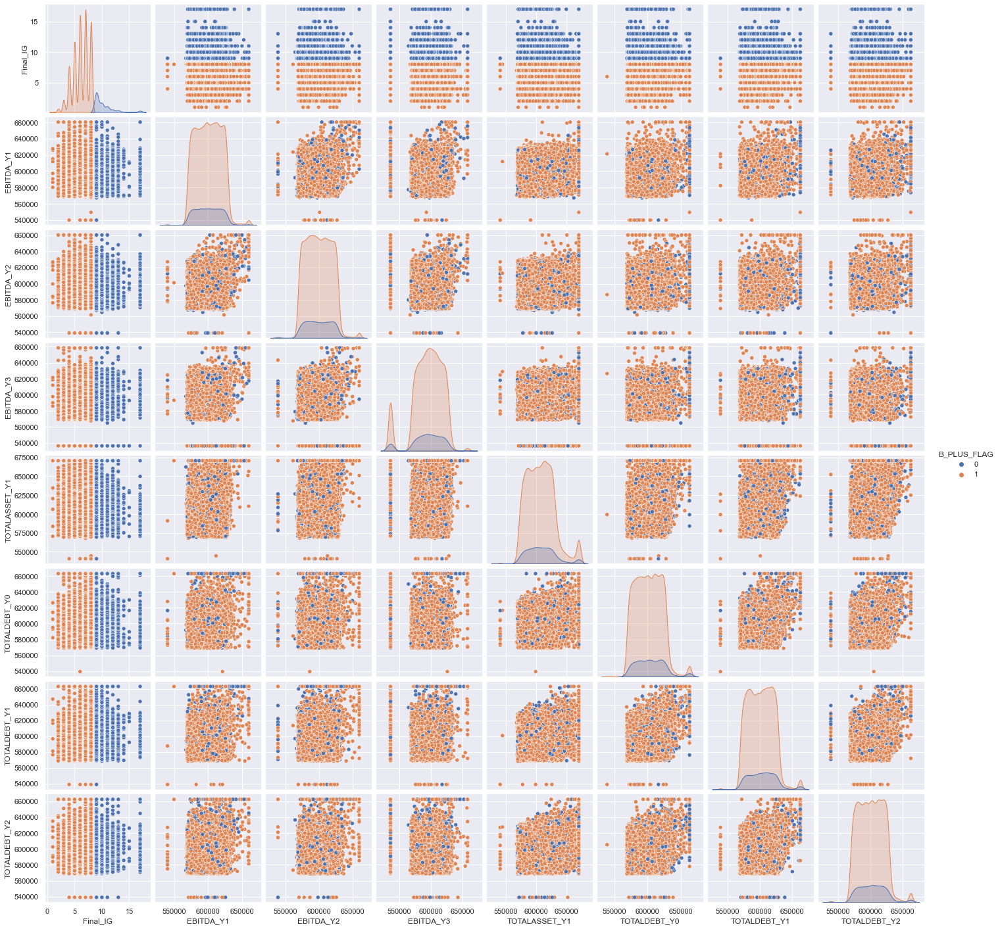

In [78]:
# An easy and convienient way to look at the distribution of each variable, 
# And their relationship with other variables is with pairplot. (We see ALOT of correlation between variables!) 
sns.pairplot(data_1, hue="B_PLUS_FLAG") 

In [79]:
df1.groupby("CUSTOMER_ID").count()

,ROW,Corp_Residence_Country_Code,BR Code,Final_IG,B_PLUS_FLAG,EBITDA_Y0,EBITDA_Y1,EBITDA_Y2,EBITDA_Y3,TOTALASSET_Y0,TOTALASSET_Y1,TOTALASSET_Y2,TOTALASSET_Y3,TOTALDEBT_Y0,TOTALDEBT_Y1,TOTALDEBT_Y2,TOTALDEBT_Y3,TOTALREVENUE_Y0,TOTALREVENUE_Y1,TOTALREVENUE_Y2,TOTALREVENUE_Y3,CURRENTASSET_Y0,CURRENTASSET_Y1,CURRENTASSET_Y2,CURRENTASSET_Y3,FIXEDASSET_Y0,FIXEDASSET_Y1,FIXEDASSET_Y2,FIXEDASSET_Y3,CURRENTLIABILITY_Y0,CURRENTLIABILITY_Y1,CURRENTLIABILITY_Y2,CURRENTLIABILITY_Y3,NONCURRLIA_Y0,NONCURRLIA_Y1,NONCURRLIA_Y2,NONCURRLIA_Y3,TOTALEQUITY_Y0,TOTALEQUITY_Y1,TOTALEQUITY_Y2,TOTALEQUITY_Y3,TOTALNETWORTH_Y0,TOTALNETWORTH_Y1,TOTALNETWORTH_Y2,TOTALNETWORTH_Y3,CAPITALIZATION_Y0,CAPITALIZATION_Y1,CAPITALIZATION_Y2,CAPITALIZATION_Y3,TOTINTEXP_Y0,TOTINTEXP_Y1,TOTINTEXP_Y2,TOTINTEXP_Y3,LEASERENTEXP_Y0,LEASERENTEXP_Y1,LEASERENTEXP_Y2,LEASERENTEXP_Y3,EBITDAR_Y0,EBITDAR_Y1,EBITDAR_Y2,EBITDAR_Y3,receivabledays_Y0,receivabledays_Y1,receivabledays_Y2,receivabledays_Y3,INVENTORYDAYS_Y0,INVENTORYDAYS_Y1,INVENTORYDAYS_Y2,INVENTORYDAYS_Y3,payableDAYS_Y0,payableDAYS_Y1,payableDAYS_Y2,payableDAYS_Y3,Capex2Dep_Y0,Capex2Dep_Y1,Capex2Dep_Y2,tangibleNetWorth_Y0,tangibleNetWorth_Y1,tangibleNetWorth_Y2,tangibleNetWorth_Y3,FIXEDCHARGECOV_Y0,FIXEDCHARGECOV_Y1,FIXEDCHARGECOV_Y2,FIXEDCHARGECOV_Y3,DEBTSERVCOV_Y0,DEBTSERVCOV_Y1,DEBTSERVCOV_Y2,DEBTSERVCOV_Y3,NETPROFIT_Y0,NETPROFIT_Y1,NETPROFIT_Y2,NETPROFIT_Y3,NETSALES_Y0,NETSALES_Y1,NETSALES_Y2,NETSALES_Y3,ASSETTURNOVER_Y0,ASSETTURNOVER_Y1,ASSETTURNOVER_Y2,ASSETTURNOVER_Y3,OPERPROFIT_Y0,OPERPROFIT_Y1,OPERPROFIT_Y2,OPERPROFIT_Y3,ARTurnover_Y0,ARTurnover_Y1,ARTurnover_Y2,ARTurnover_Y3,Inventory_Y0,Inventory_Y1,Inventory_Y2,Inventory_Y3,RETAINED_EARNINGS_Y0,RETAINED_EARNINGS_Y1,RETAINED_EARNINGS_Y2,RETAINED_EARNINGS_Y3,FCF_Y0,FCF_Y1,FCF_Y2,CCE_Y0,CCE_Y1,CCE_Y2,CCE_Y3,Date,Year,Month
CUSTOMER_ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2
3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3
5,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2
6,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2
9,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14026,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9
1402

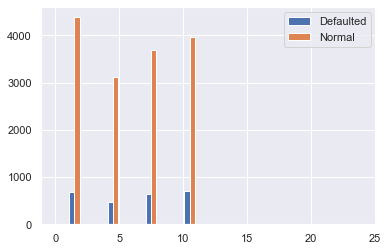

In [80]:
plt.hist( [ df1.loc[ df1['B_PLUS_FLAG']==0, 'Month'], df1.loc[ df1['B_PLUS_FLAG']==1, 'Month'] ],
         label=['Defaulted','Normal'], bins=np.linspace(0,24,25))
plt.legend()
plt.show()

# It seems that in the Q4 and Q1, there seems to be the most number of risky / default cases applied

In [81]:
df1.skew()
# Alot of columns are heavily skewed, with EDITDAR_Y3 being the highest 
# We will need to normalize our columns 

ROW                            0.029152
Corp_Residence_Country_Code    0.889522
BR Code                        2.031714
CUSTOMER_ID                    0.426207
Final_IG                       0.869618
B_PLUS_FLAG                   -2.064168
EBITDA_Y0                      0.170873
EBITDA_Y1                      0.143883
EBITDA_Y2                      0.167039
EBITDA_Y3                     -0.795952
TOTALASSET_Y0                  0.689754
TOTALASSET_Y1                  0.649007
TOTALASSET_Y2                  0.629016
TOTALASSET_Y3                 -0.361566
TOTALDEBT_Y0                   0.403172
TOTALDEBT_Y1                   0.347657
TOTALDEBT_Y2                   0.305293
TOTALDEBT_Y3                  -0.674423
TOTALREVENUE_Y0                0.589029
TOTALREVENUE_Y1                0.585309
TOTALREVENUE_Y2                0.559361
TOTALREVENUE_Y3               -0.371790
CURRENTASSET_Y0                0.418766
CURRENTASSET_Y1                0.352614
CURRENTASSET_Y2                0.357088


## Data Distributions by Features & Investment Type <a class="anchor" id="2.2"></a>

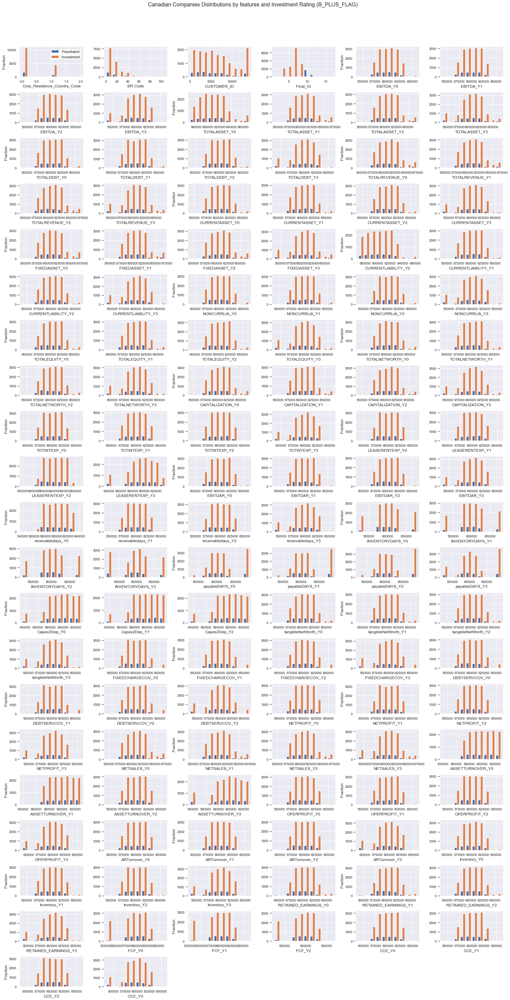

In [82]:
####################################
#### Canadian Companies Dataset ####
####################################

# get the non-financial columns
troublesome_features = ['ROW','Date','Year', 'Month']
fin_features = df1.drop(troublesome_features, axis=1)

label_cols = ['B_PLUS_FLAG']
data_cols = list(fin_features.columns[ fin_features.columns != 'B_PLUS_FLAG' ])
data = df1.copy(deep=True)

# Draw their distributions
# Plot the data by each feature and it's default rating

axarr = [[]]*len(data_cols)
columns = 6
rows = int( np.ceil( len(data_cols) / columns ) )
f, fig = plt.subplots( figsize=(columns*3.5, rows*2) )

f.suptitle('Canadian Companies Distributions by features and Investment Rating (B_PLUS_FLAG)', size=16)


for i, col in enumerate(data_cols[:]):
    axarr[i] = plt.subplot2grid( (int(rows), int(columns)), (int(i//columns), int(i%columns)) )
    axarr[i].hist( [ data.loc[ data.B_PLUS_FLAG == 0, col ], data.loc[ data.B_PLUS_FLAG == 1, col ] ], label=['Fraudulent','Investment'], )
    axarr[i].set_xlabel(col, size=12)
    axarr[i].tick_params(axis='both', labelsize=10)
    if i == 0: 
        legend = axarr[i].legend()
        legend.get_frame().set_facecolor('white')
    if i%4 != 0 : 
        axarr[i].tick_params(axis='y', left='off', labelleft='off')
    else:
        axarr[i].set_ylabel('Fraction',size=12)

plt.tight_layout(rect=[0,0,1,0.95]) # xmin, ymin, xmax, ymax
# plt.savefig('plots/Engineered_Data_Distributions.png')
plt.show()

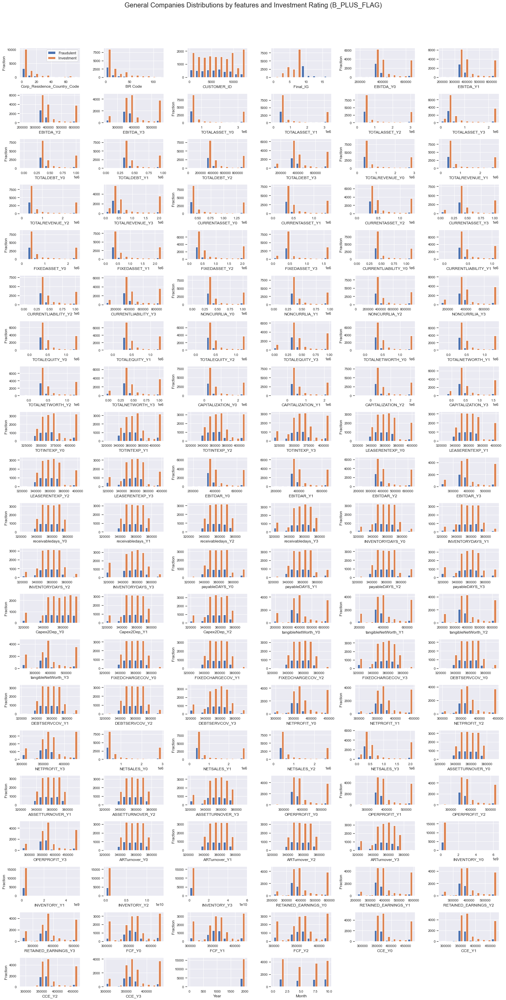

In [83]:
###################################
#### General Companies Dataset ####
###################################

# get the non-financial columns
troublesome_features = ['ROW','Date']
fin_features = df2.drop(troublesome_features, axis=1)

label_cols = ['B_PLUS_FLAG']
data_cols = list(fin_features.columns[ fin_features.columns != 'B_PLUS_FLAG' ])
data = df2.copy(deep=True)

# Draw their distributions
# Plot the data by each feature and it's default rating

axarr = [[]]*len(data_cols)
columns = 6
rows = int( np.ceil( len(data_cols) / columns ) )
f, fig = plt.subplots( figsize=(columns*3.5, rows*2) )

f.suptitle('General Companies Distributions by features and Investment Rating (B_PLUS_FLAG)', size=20)

for i, col in enumerate(data_cols[:]):
    axarr[i] = plt.subplot2grid( (int(rows), int(columns)), (int(i//columns), int(i%columns)) )
    axarr[i].hist( [ data.loc[ data.B_PLUS_FLAG == 0, col ], data.loc[ data.B_PLUS_FLAG == 1, col ] ], label=['Fraudulent','Investment'], )
    axarr[i].set_xlabel(col, size=12)
    axarr[i].tick_params(axis='both', labelsize=10)
    if i == 0: 
        legend = axarr[i].legend()
        legend.get_frame().set_facecolor('white')
    if i%4 != 0 : 
        axarr[i].tick_params(axis='y', left='off', labelleft='off')
    else:
        axarr[i].set_ylabel('Fraction',size=12)

plt.tight_layout(rect=[0,0,1,0.95]) # xmin, ymin, xmax, ymax
# plt.savefig('plots/Engineered_Data_Distributions.png')
plt.show()

In [1]:
df1.head()

NameError: name 'df1' is not defined